In [9]:
import matplotlib.pyplot as plt
import strauss
from strauss.sonification import Sonification
from strauss import channels
from strauss.generator import Sampler
from strauss.score import Score
from strauss.generator import Synthesizer
import IPython.display as ipd
from strauss.sources import Events
import os
from scipy.interpolate import interp1d
import numpy as np
import copy
import wavio as wav

import sys
sys.path.append('../')
import matplotlib.pyplot as plt
from PIL import Image
import numpy as np
import time
from mike_code import LaguerreAmplitudes
from functionalities import *
import matplotlib.cm as cm
from skimage.transform import resize_local_mean
from combine_sonifications import combine_save_sonifications

import time

from FLEX_ed import ExpandGalaxies, BeefIt


import ffmpeg
import glob

The history saving thread hit an unexpected error (OperationalError('attempt to write a readonly database')).History will not be written to the database.


In [10]:
elliptical = ['GZ2_images/844.jpg','GZ2_images/290897.jpg','GZ2_images/287823.jpg'] 
spiral = ['GZ2_images/290248.jpg','GZ2_images/291065.jpg','GZ2_images/295140.jpg'] #293157 is meh on nearby, as is 293764
edge_on = ['GZ2_images/99129.jpg','GZ2_images/293446.jpg','GZ2_images/294943.jpg']
barred = ['GZ2_images/290722.jpg','GZ2_images/288813.jpg','GZ2_images/294348.jpg'] #288325 has bearby
interacting = ['GZ2_images/290026.jpg','GZ2_images/289500.jpg','GZ2_images/288109.jpg']
artefact = ['GZ2_images/258142.jpg', 'GZ2_images/169394.jpg','GZ2_images/261434.jpg']

# first mapping in the survey - m = 7, n = 7, m to octaves and n to notes - length = 3 seconds, notes on D major scale"

In [11]:
test1 = Sampler("../op1 synth 8.sf2", sf_preset=0)
test1_generator = copy.copy(test1)

In [12]:
def mod_map_to_sounds_octave_ampcutoff(cos_cos, sin_cos):
    note_list = np.array(['D', 'E', 'F#', 'G', 'A', 'B', 'C#'])
    mmax = cos_cos.shape[0]
    nmax = cos_cos.shape[1]

    modulus = np.sqrt(cos_cos**2 + sin_cos**2)
    
    abs_max = np.max(modulus)
    note_dict = {}
    
    for m in range(mmax):
        octave = m + 1 #hmm. running into issues that there are only some notes at m = 0 and m = 8... 
        #can kinda avoid bc last few terms are usually low amplitude but not really a fix here...
        for n in range(nmax):
            amp = modulus[m,n]/modulus[0,0]
            if abs(amp) >= 0.01*(abs_max/modulus[0,0]): #will only play terms with amplitude at least 1% of max
                note = note_list[n] + str(octave)
                note_dict[note] = abs(amp)

    print('returning full set of notes')
    return note_dict

# doing the mapping - >

In [13]:
full_collection

[['GZ2_images/844.jpg', 'GZ2_images/290897.jpg', 'GZ2_images/287823.jpg'],
 ['GZ2_images/99129.jpg', 'GZ2_images/293446.jpg', 'GZ2_images/294943.jpg'],
 ['GZ2_images/290248.jpg', 'GZ2_images/291065.jpg', 'GZ2_images/295140.jpg'],
 ['GZ2_images/290722.jpg', 'GZ2_images/288813.jpg', 'GZ2_images/294348.jpg'],
 ['GZ2_images/290026.jpg', 'GZ2_images/289500.jpg', 'GZ2_images/288109.jpg'],
 ['GZ2_images/258142.jpg', 'GZ2_images/169394.jpg', 'GZ2_images/261434.jpg']]

elliptical
opening image
Reff =  29.11686406230761  Galaxy Radius:  174.70118437384565
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.1765405126063389 -1.6052432754683108
center finding iteration 0
center finding iteration 50
Center of mass at x = 1.4309032385321974, y = 1.0822956657103904
finding best rscl
New rscl value: 29
updating to new_mmax, new_nmax


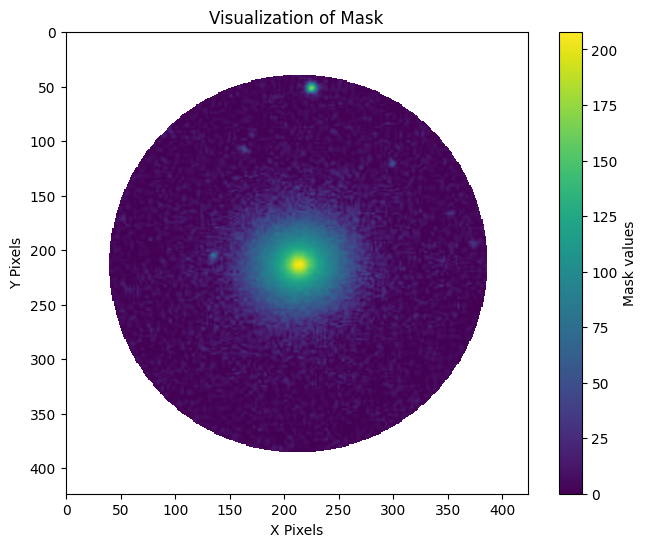

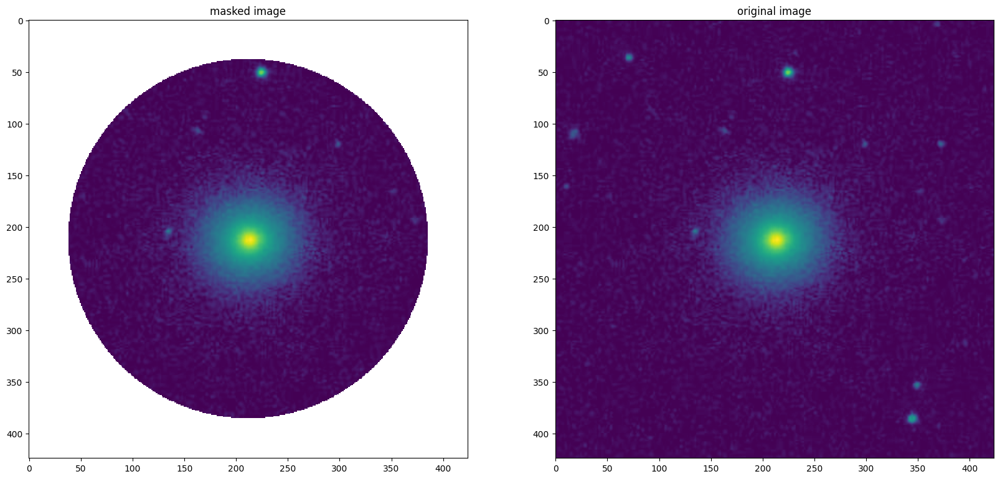

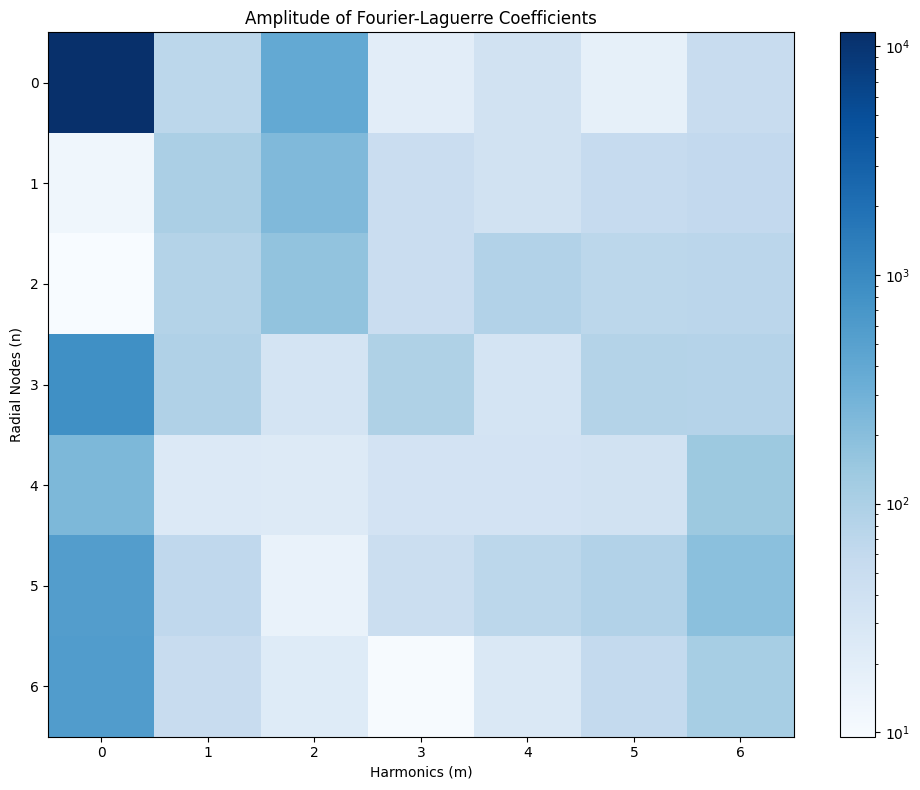

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


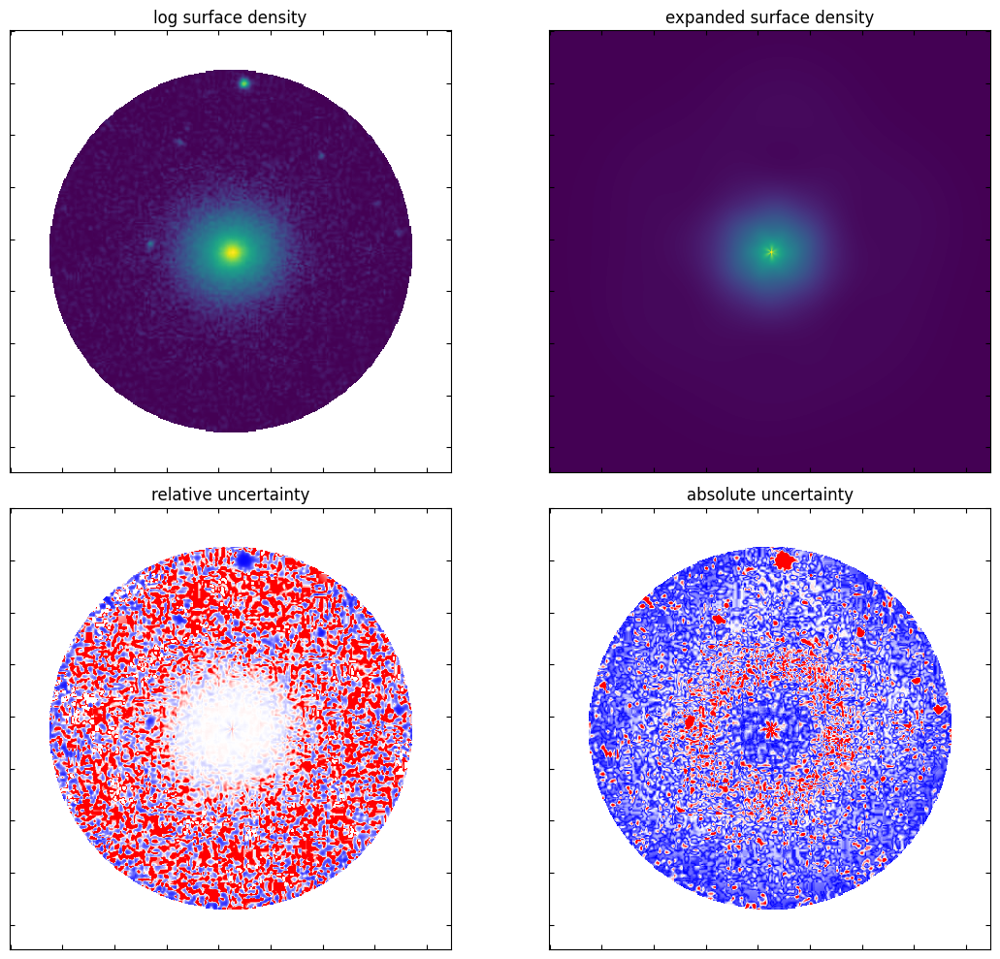

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 10/10 [00:00<00:00, 408.34it/s]

Saved 844_elliptical_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 844_elliptical_mapping2.wav to 844_elliptical_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   236.38x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   242.50x|    0:00 
------------

elliptical
opening image
Reff =  38.36866489901669  Galaxy Radius:  230.21198939410016
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.9678090232864707 2.582800977164008
center finding iteration 0
Center of mass at x = 3.032965846021149, y = 4.006245159918744
finding best rscl
New rscl value: 31
updating to new_mmax, new_nmax


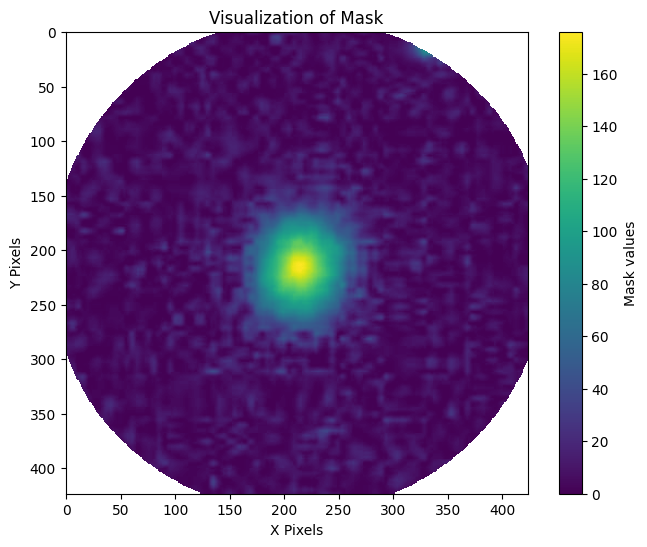

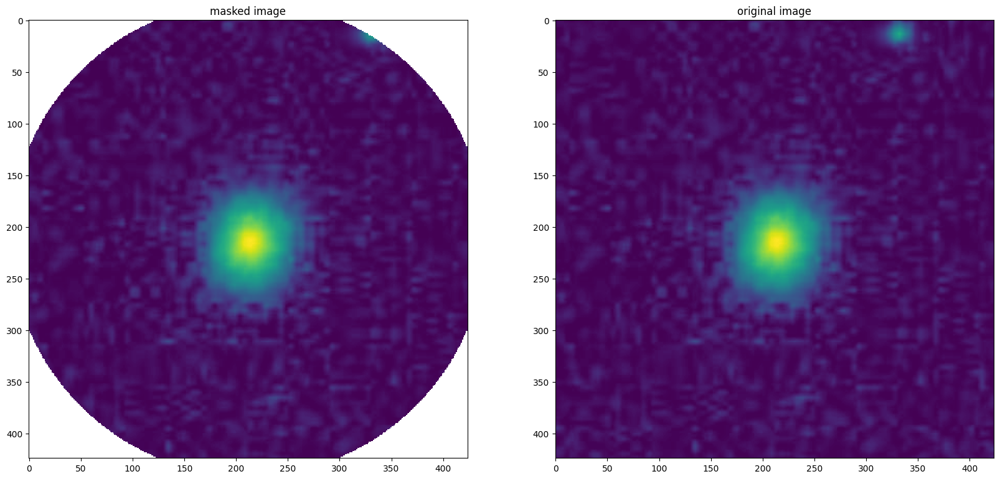

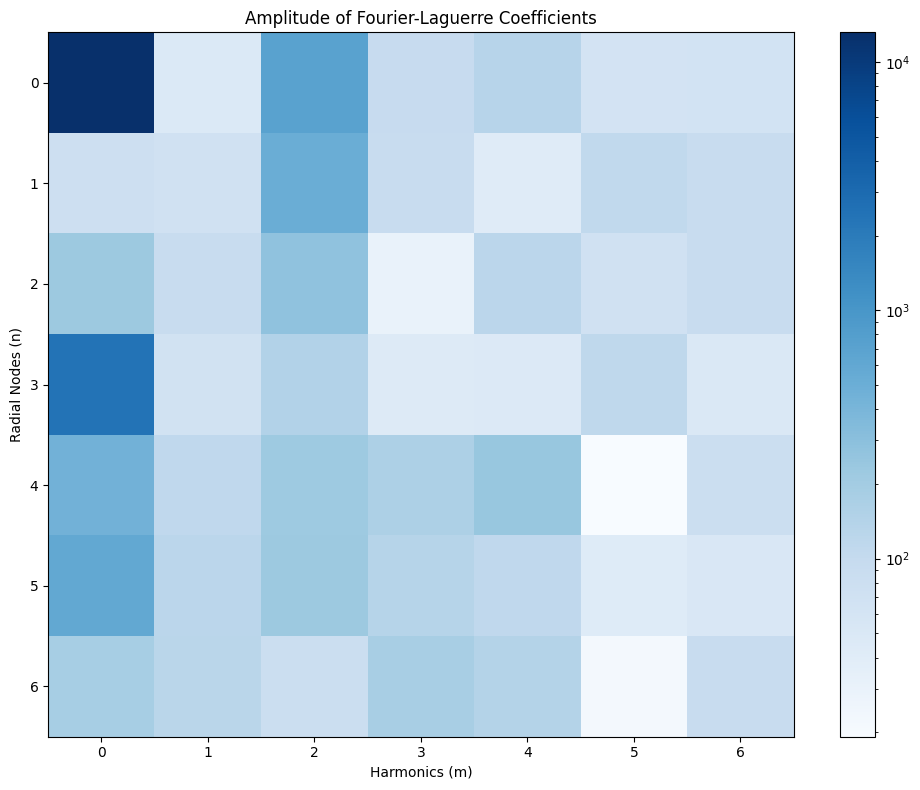

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


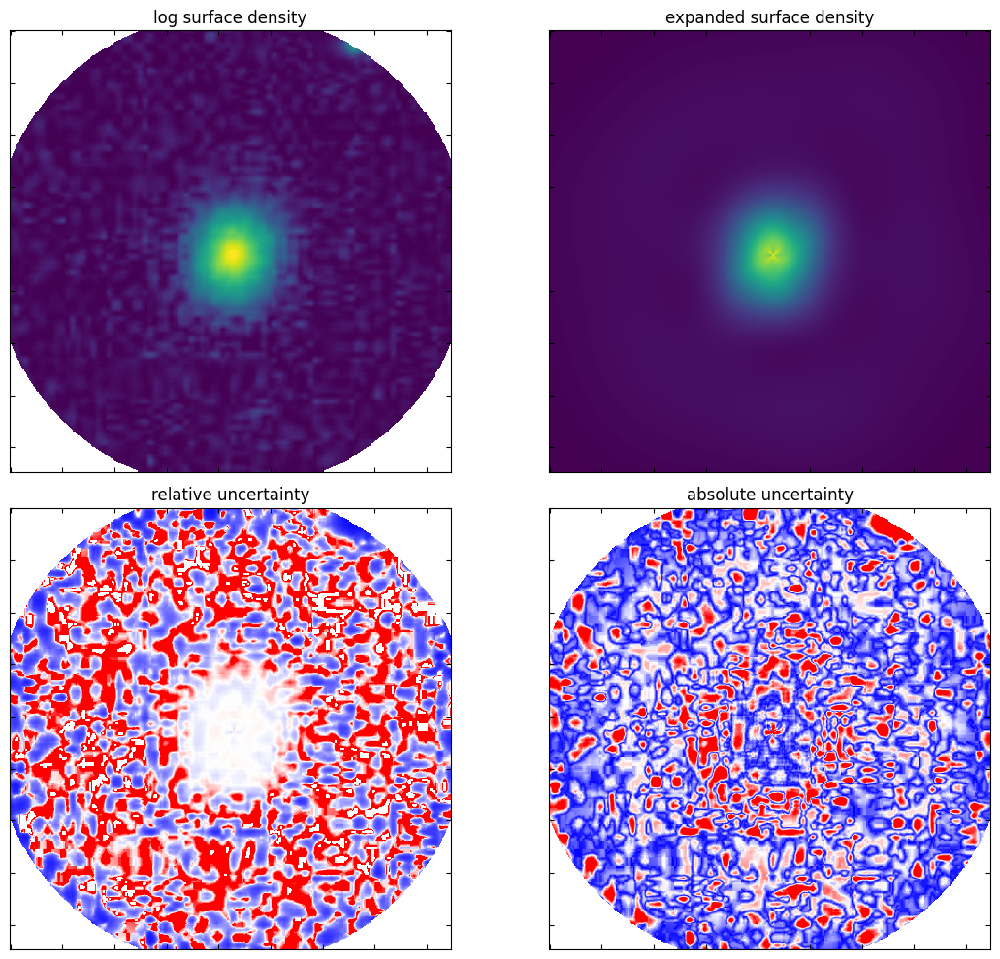

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 17/17 [00:00<00:00, 421.43it/s]

Saved 290897_elliptical_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 290897_elliptical_mapping2.wav to 290897_elliptical_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   229.03x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   240.08x|    0:00 
---

elliptical
opening image
Reff =  42.186815252979756  Galaxy Radius:  253.12089151787853
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.0605402118338096 0.1103802591466595
center finding iteration 0
Center of mass at x = 3.526551185411093, y = 2.954480643207312
finding best rscl
New rscl value: 40
updating to new_mmax, new_nmax


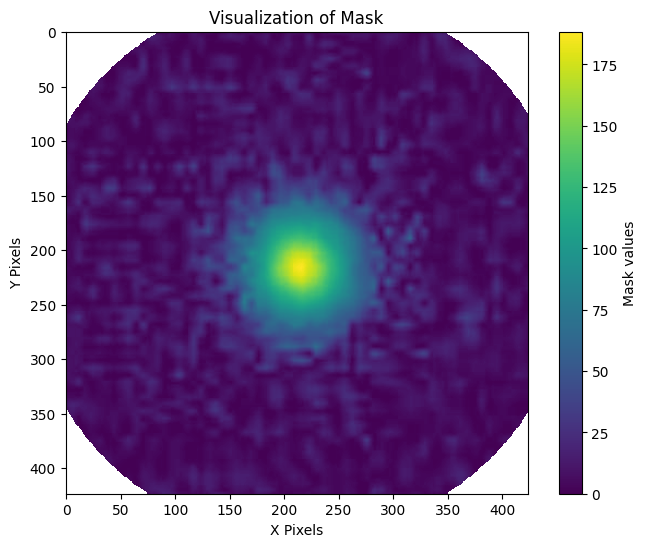

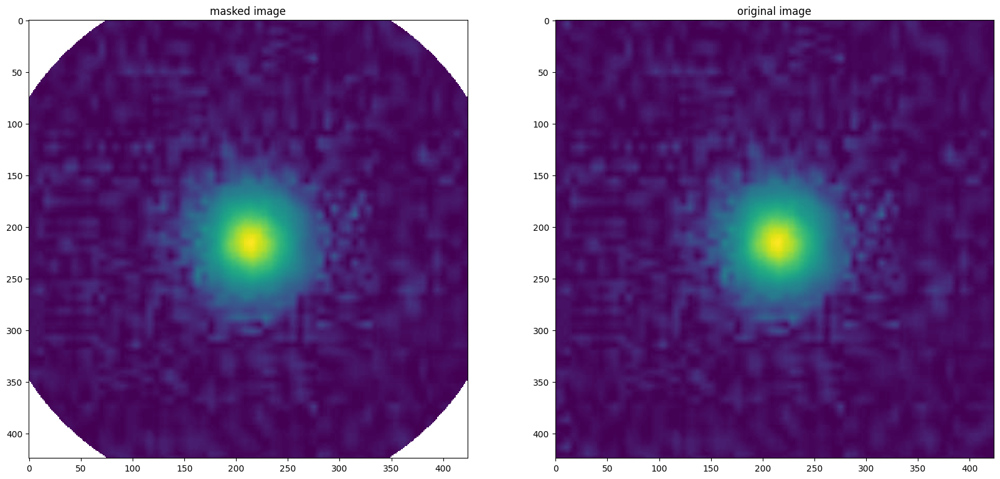

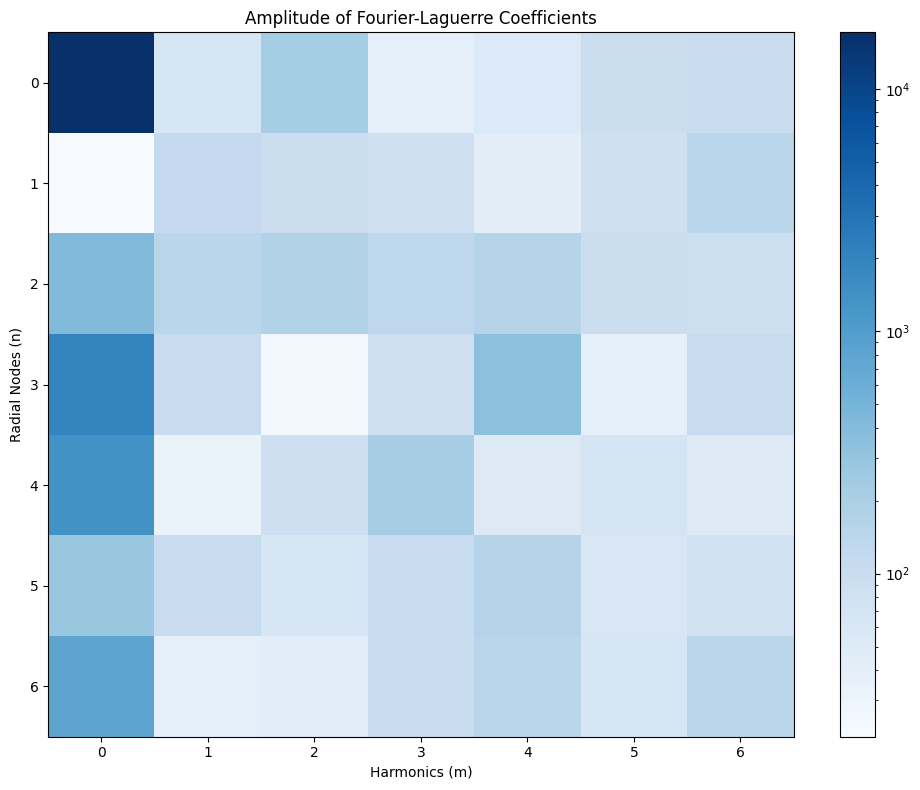

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


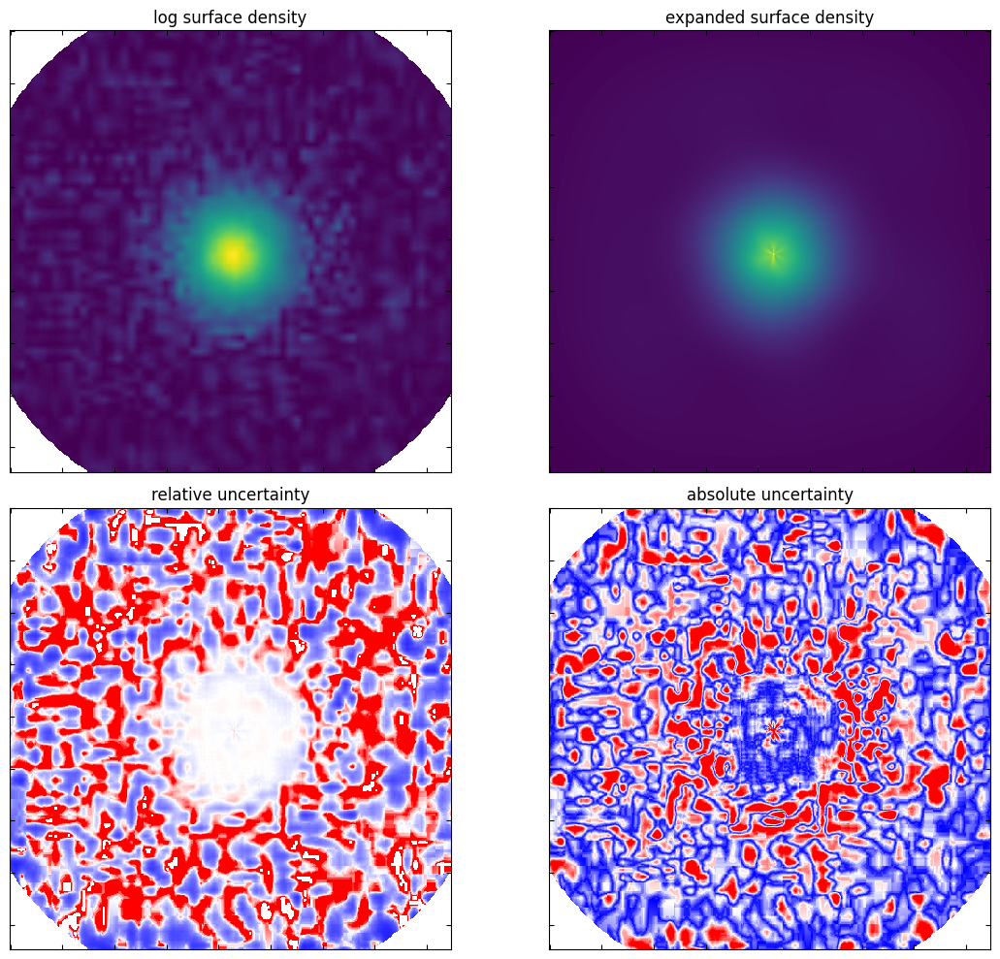

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 10/10 [00:00<00:00, 459.28it/s]

Saved 287823_elliptical_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 287823_elliptical_mapping2.wav to 287823_elliptical_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   256.99x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   261.61x|    0:00 
---

Reff =  16.64334529046593  Galaxy Radius:  99.86007174279558
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.793046070050386 0.9761290948889891
center finding iteration 0
Center of mass at x = 2.0552971346423865, y = 1.2031056334003478
finding best rscl
New rscl value: 29
updating to new_mmax, new_nmax


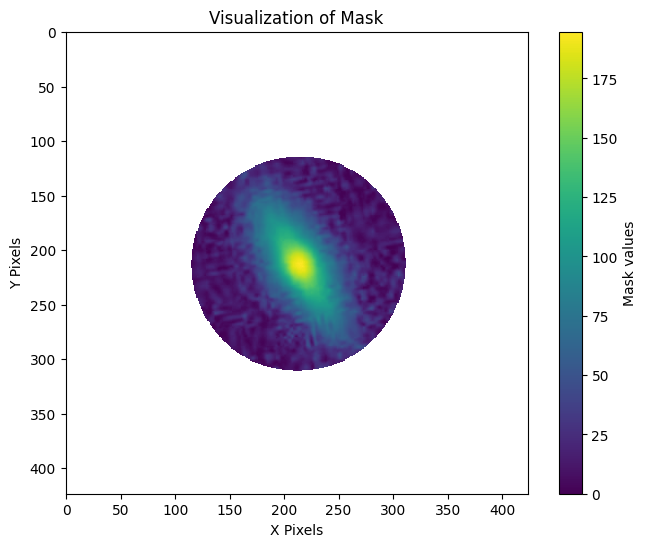

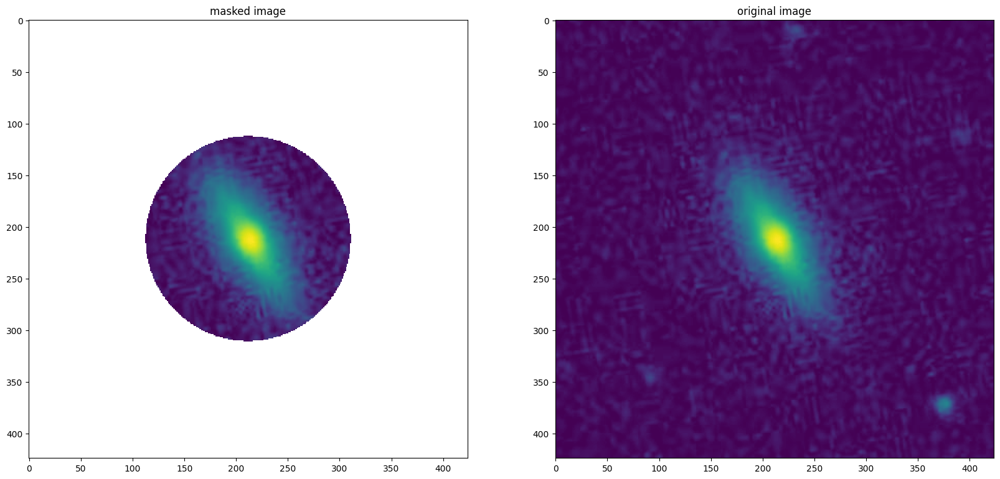

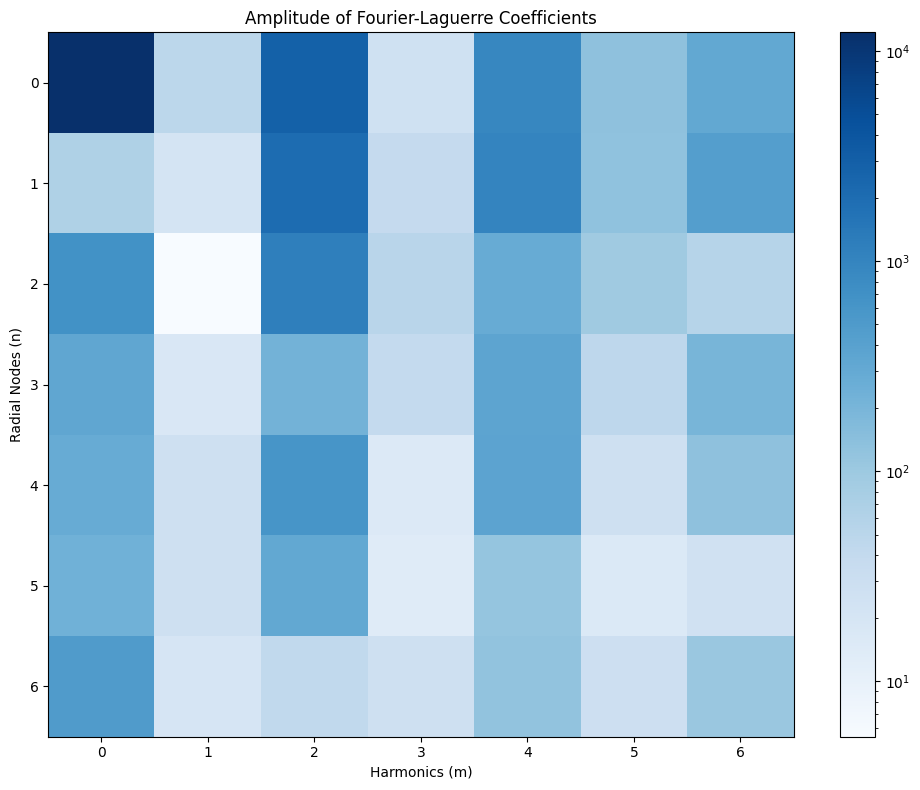

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


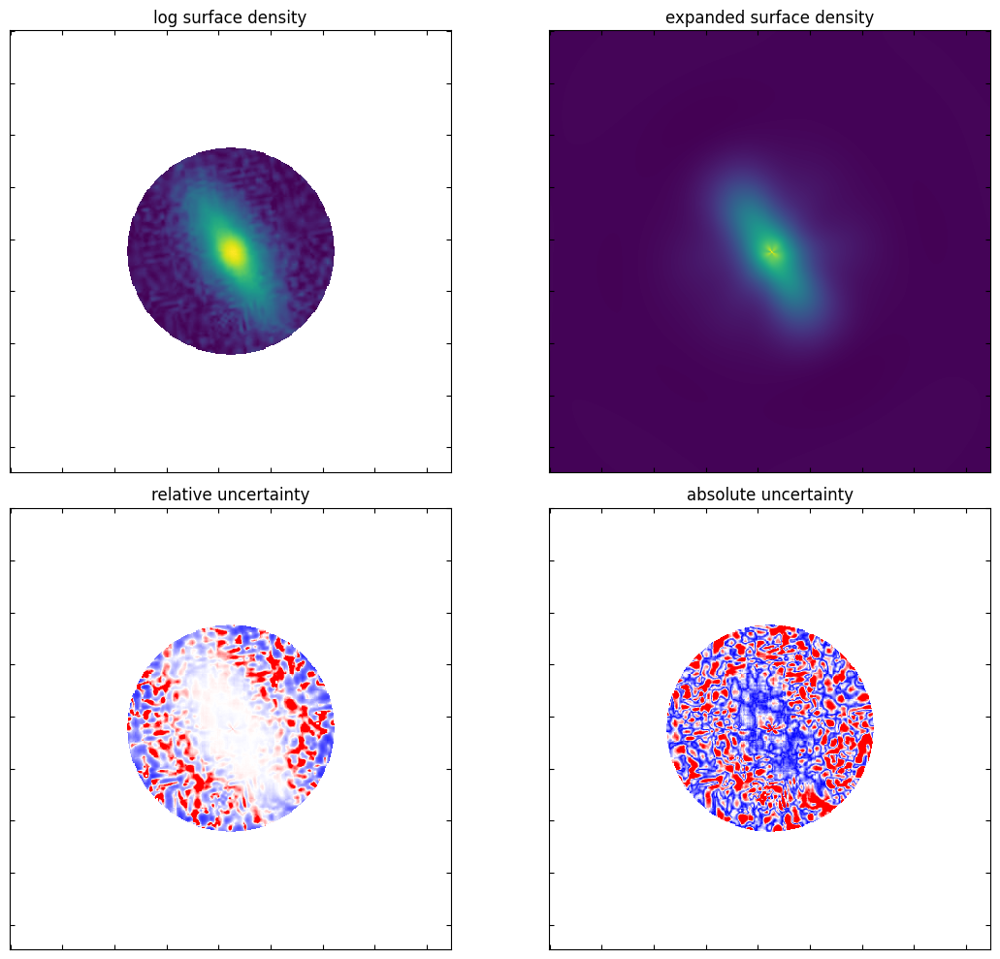

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 24/24 [00:00<00:00, 560.67it/s]

Saved 99129_edge_on_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 99129_edge_on_mapping2.wav to 99129_edge_on_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   254.59x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   262.64x|    0:00 
---------------

Reff =  13.517799592155896  Galaxy Radius:  81.10679755293538
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 1.7390558564786198 0.7835624213458492
center finding iteration 0
Center of mass at x = 2.4142887293015516, y = 1.0520930653444514
finding best rscl
New rscl value: 28
updating to new_mmax, new_nmax


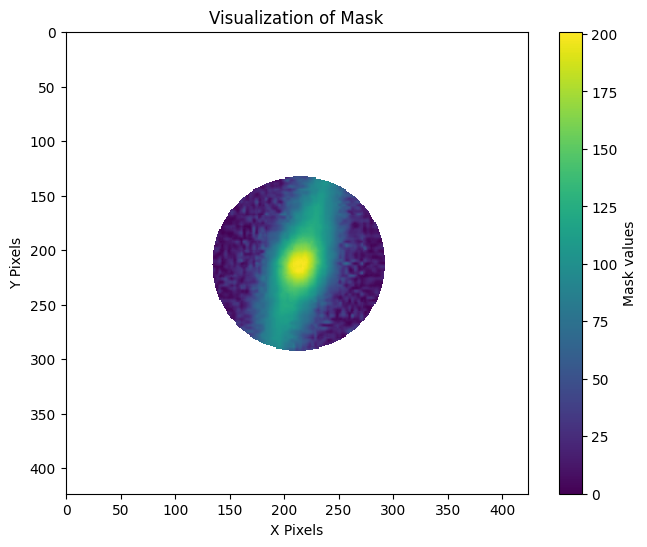

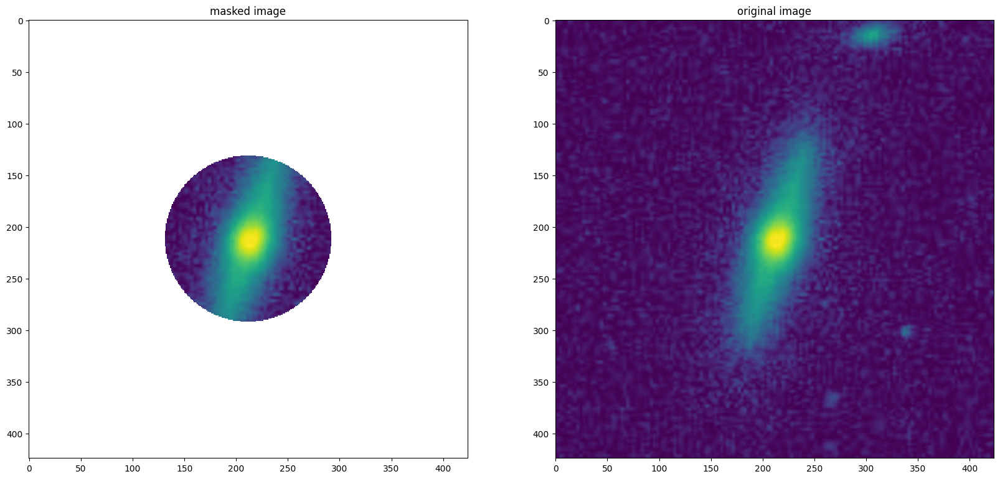

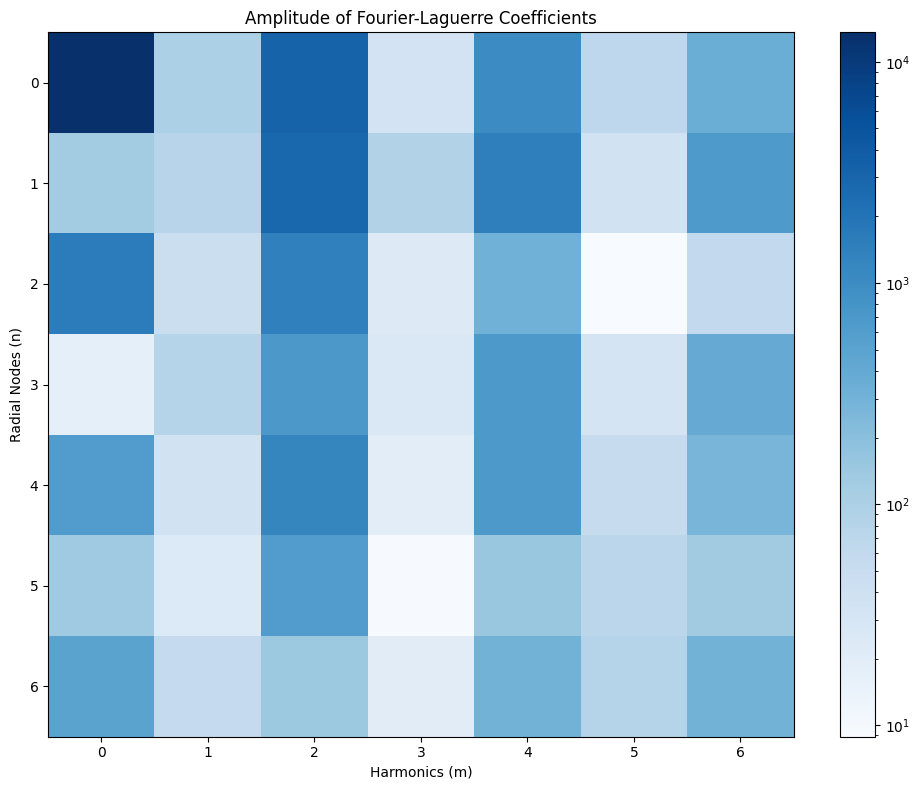

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


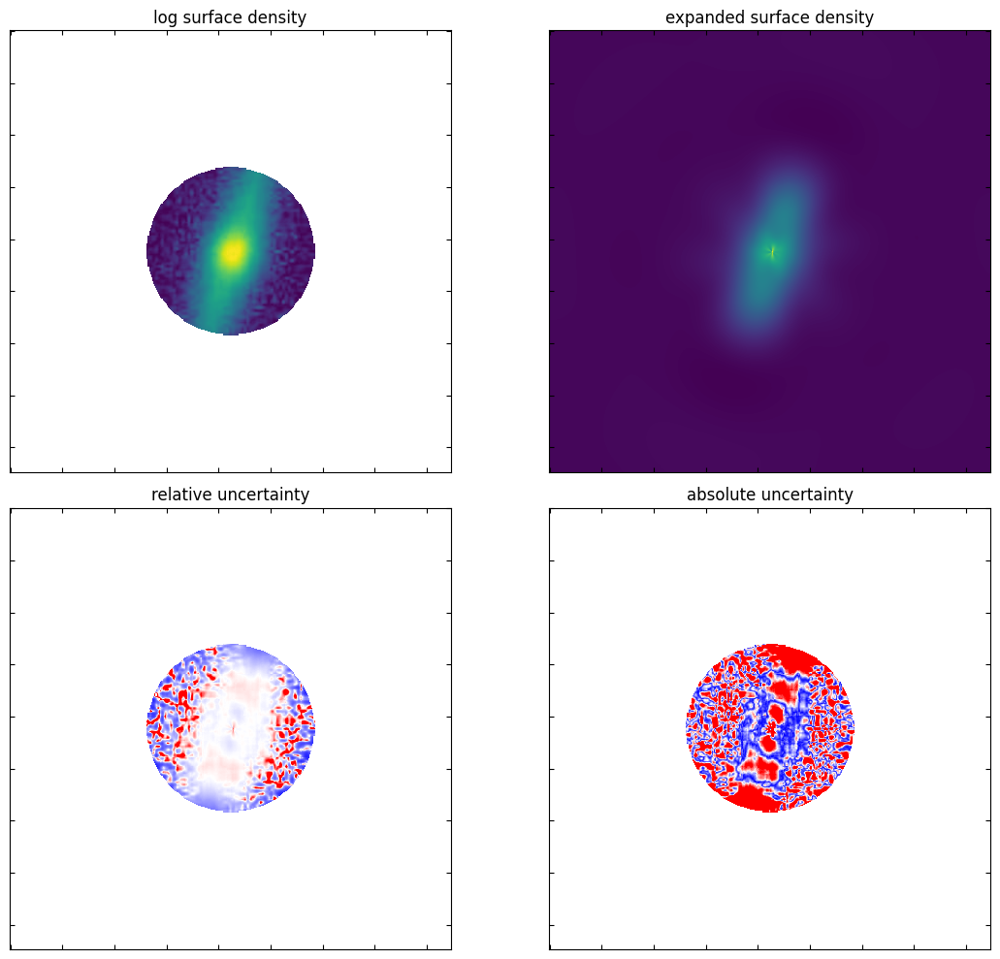

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 23/23 [00:00<00:00, 620.21it/s]

Saved 293446_edge_on_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 293446_edge_on_mapping2.wav to 293446_edge_on_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   250.76x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   255.66x|    0:00 
------------

Reff =  26.227310408118733  Galaxy Radius:  157.36386244871238
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -1.6605938613028461 6.294069451866914
center finding iteration 0
center finding iteration 50
Center of mass at x = -0.39218708296933236, y = 8.00085665192692
finding best rscl
New rscl value: 25
updating to new_mmax, new_nmax


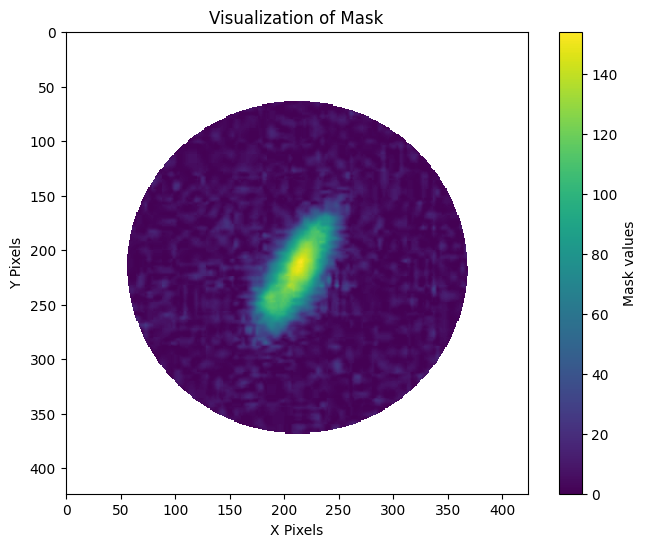

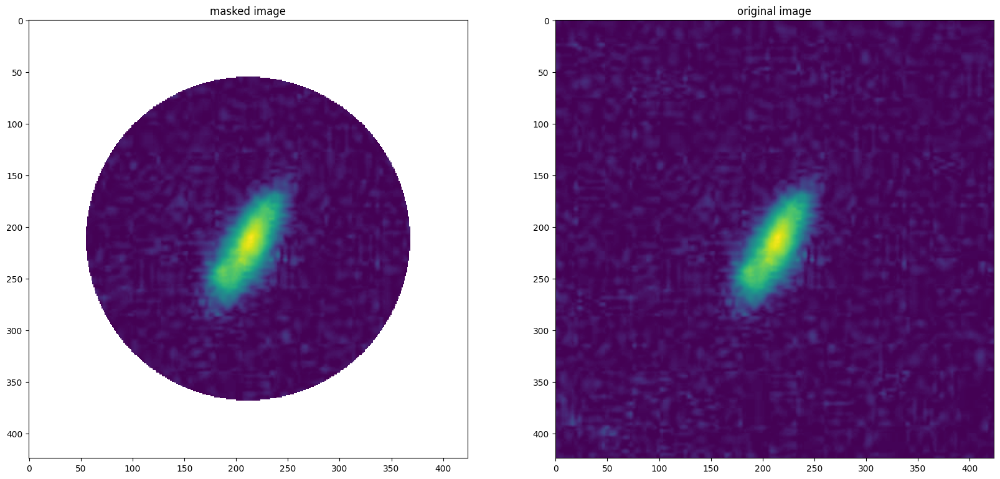

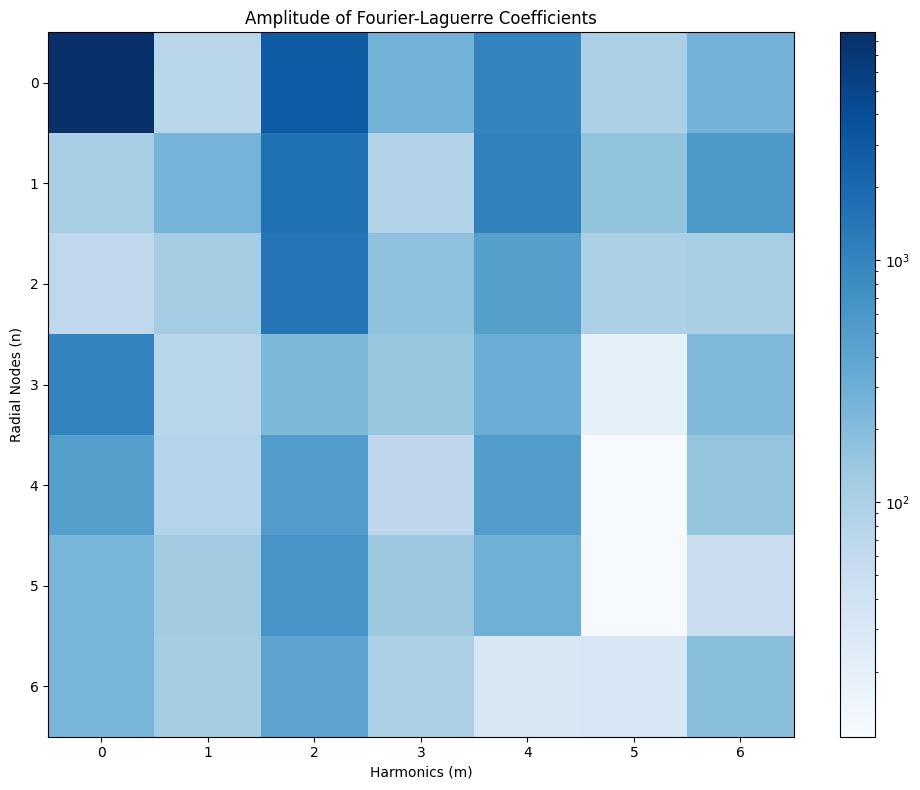

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


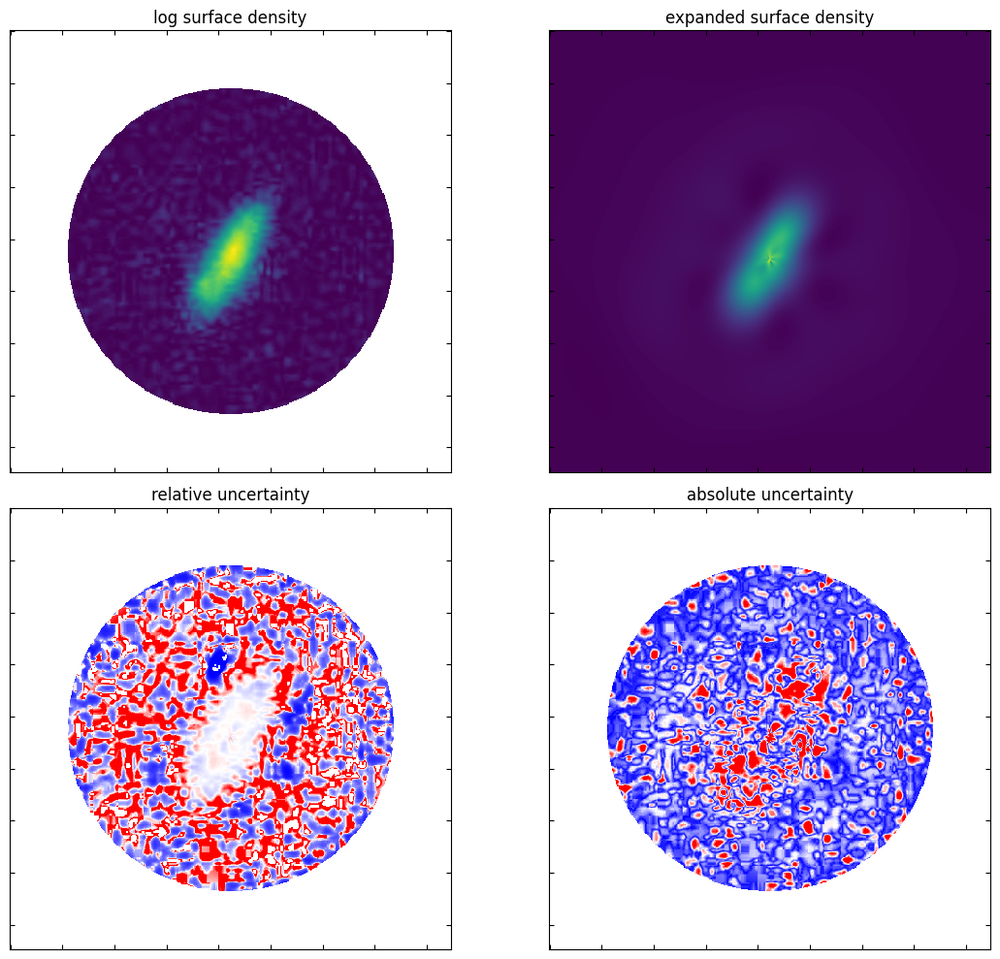

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 38/38 [00:00<00:00, 415.43it/s]

Saved 294943_edge_on_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 294943_edge_on_mapping2.wav to 294943_edge_on_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   249.01x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   257.43x|    0:00 
------------

spiral
opening image
Reff =  39.15054271283767  Galaxy Radius:  234.903256277026
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -0.052563878516771675 4.147312496089642
center finding iteration 0
center finding iteration 50
Center of mass at x = 1.6320020835386158, y = 2.12626209617183
finding best rscl
New rscl value: 30
updating to new_mmax, new_nmax


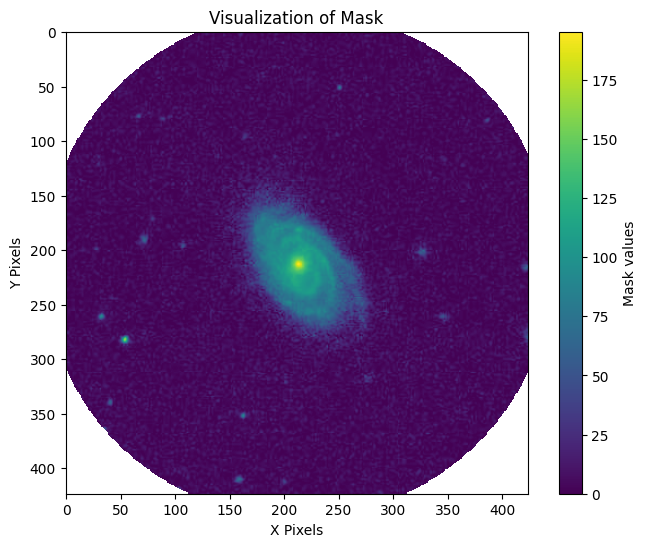

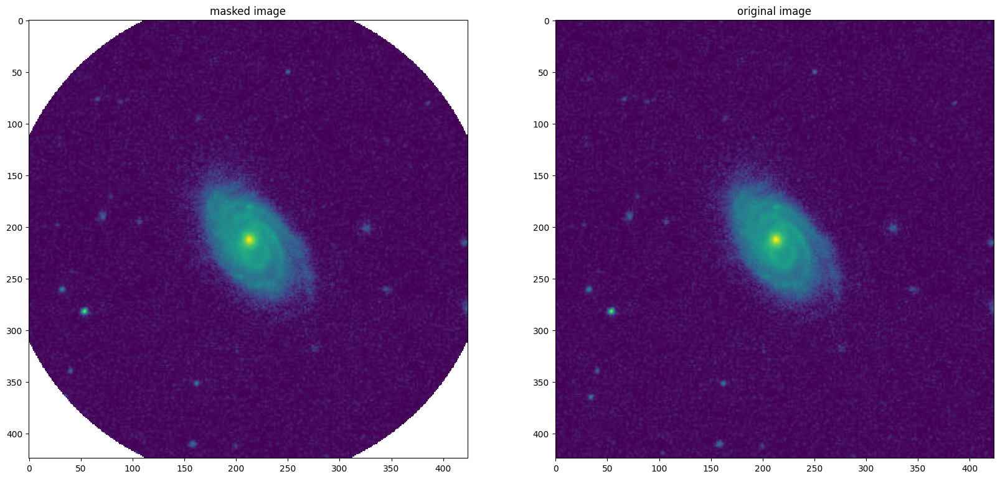

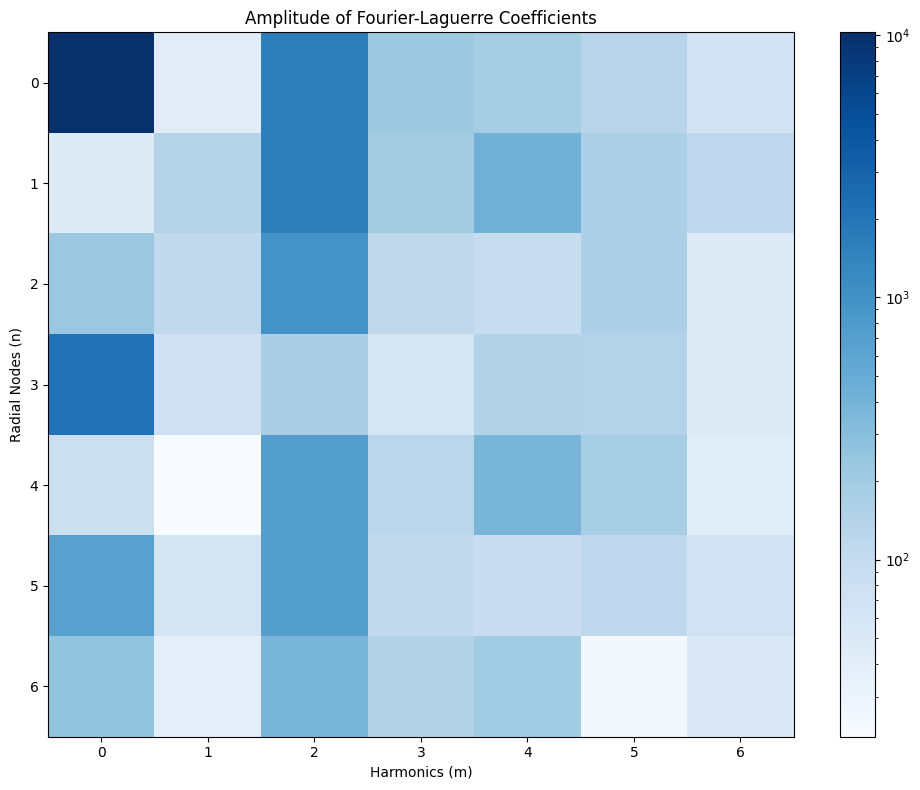

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


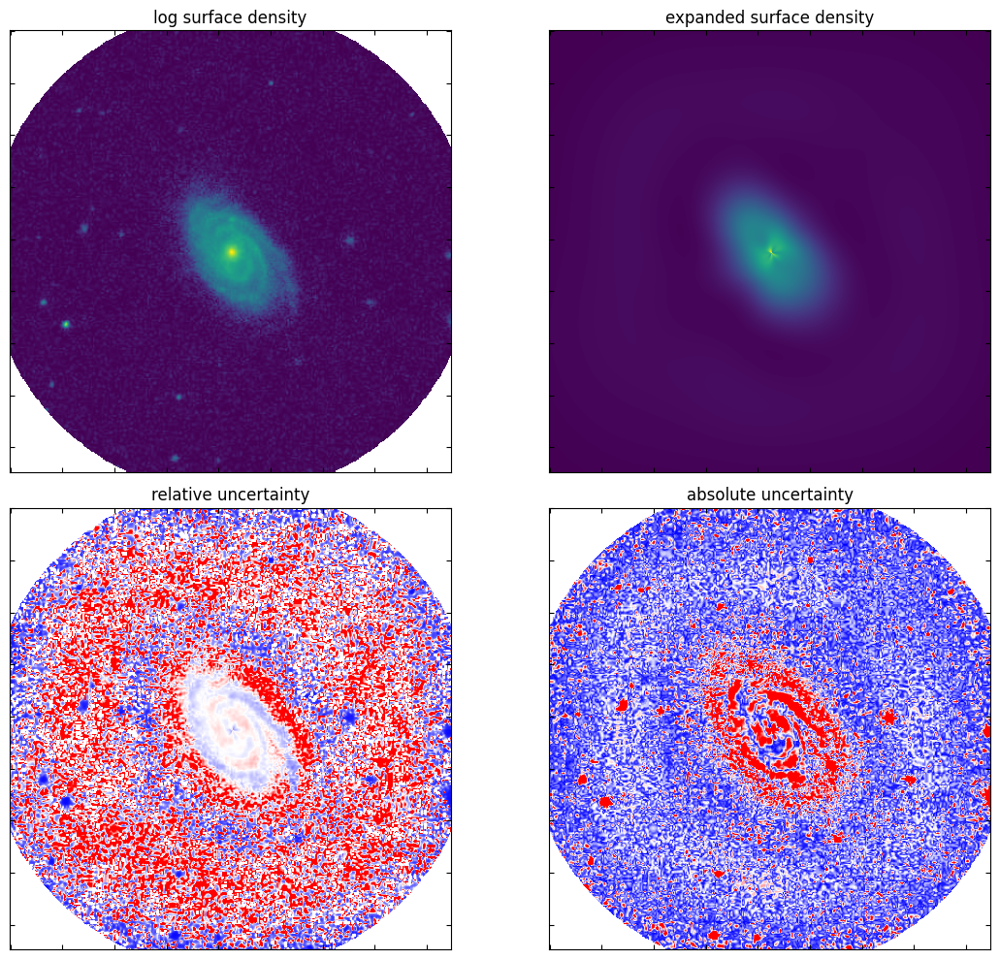

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 32/32 [00:00<00:00, 606.88it/s]

Saved 290248_spiral_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 290248_spiral_mapping2.wav to 290248_spiral_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   247.35x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   256.16x|    0:00 
---------------

spiral
opening image
Reff =  27.175558744078963  Galaxy Radius:  163.0533524644738
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 2.13225063238741 -0.43156942530889764
center finding iteration 0
Center of mass at x = 0.8353254967126125, y = 0.5432317877000615
finding best rscl
New rscl value: 31
updating to new_mmax, new_nmax


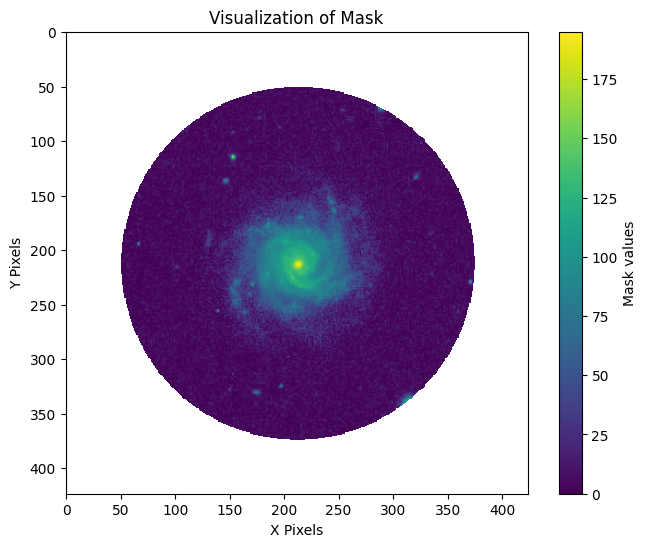

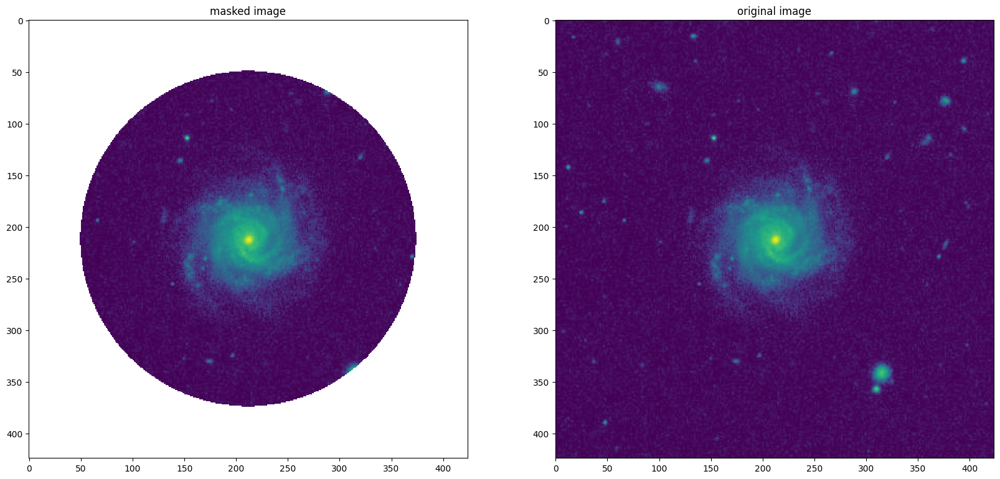

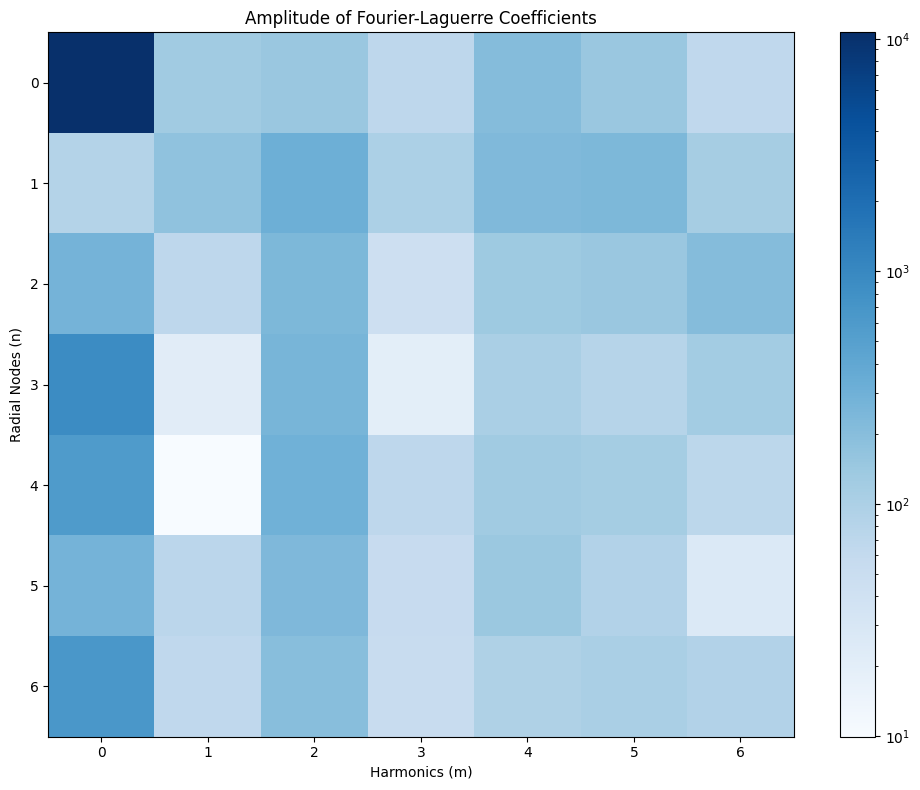

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


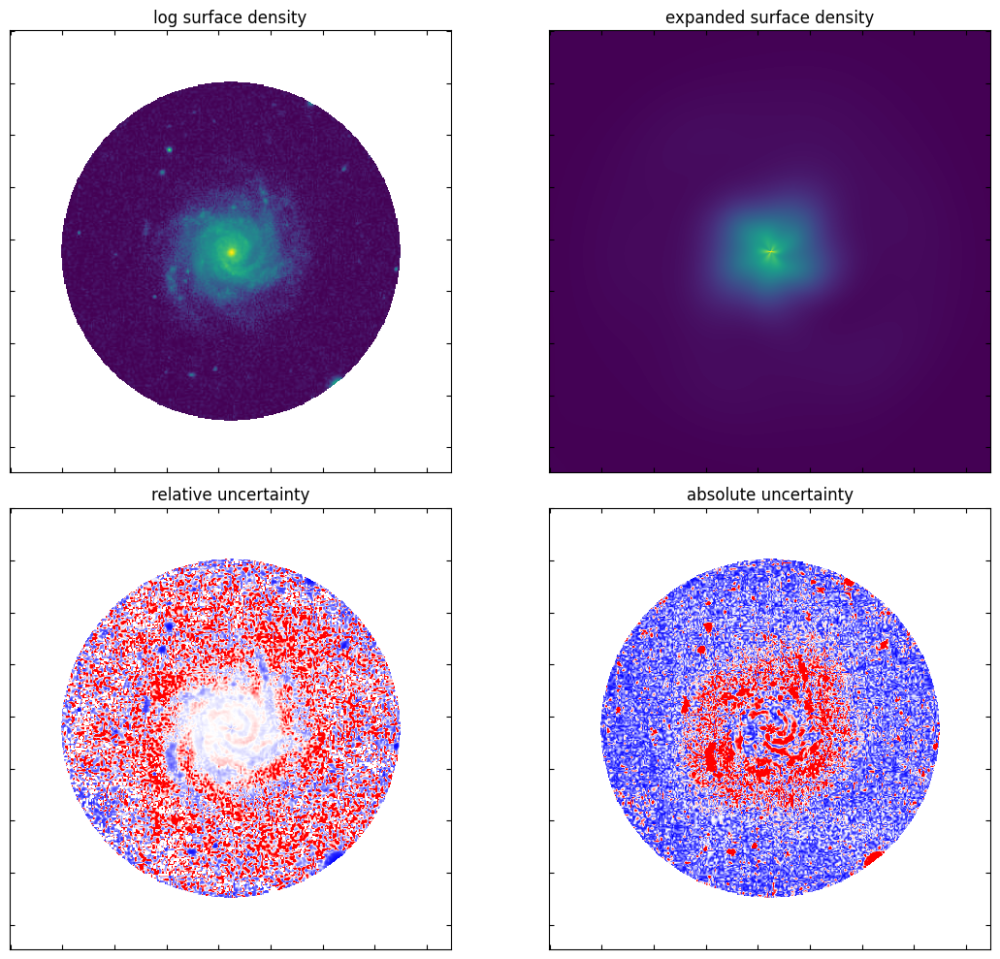

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 27/27 [00:00<00:00, 609.17it/s]

Saved 291065_spiral_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 291065_spiral_mapping2.wav to 291065_spiral_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   259.63x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   267.40x|    0:00 
---------------

spiral
opening image
Reff =  26.50107319468423  Galaxy Radius:  159.00643916810537
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -0.3429835056064975 0.10584217393966959
center finding iteration 0
Center of mass at x = 0.5964622224558268, y = 1.110248295522857
finding best rscl
New rscl value: 28
updating to new_mmax, new_nmax


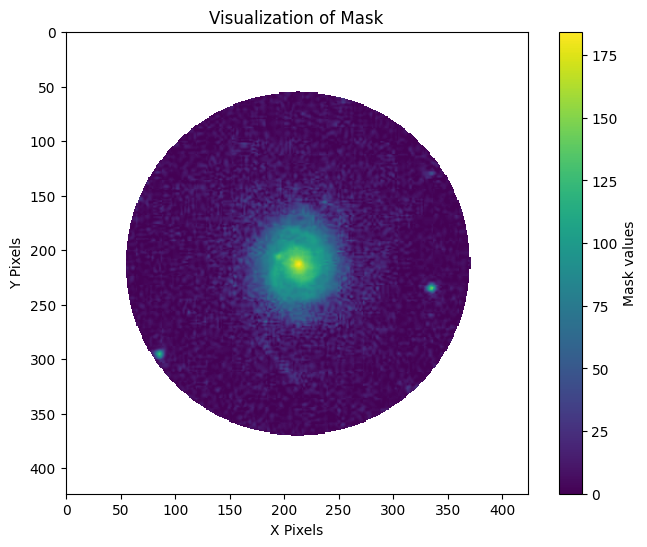

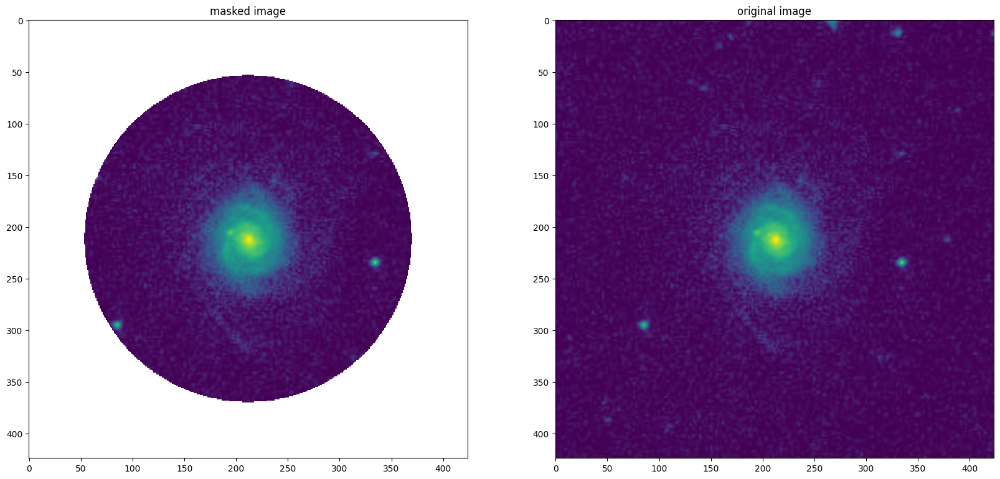

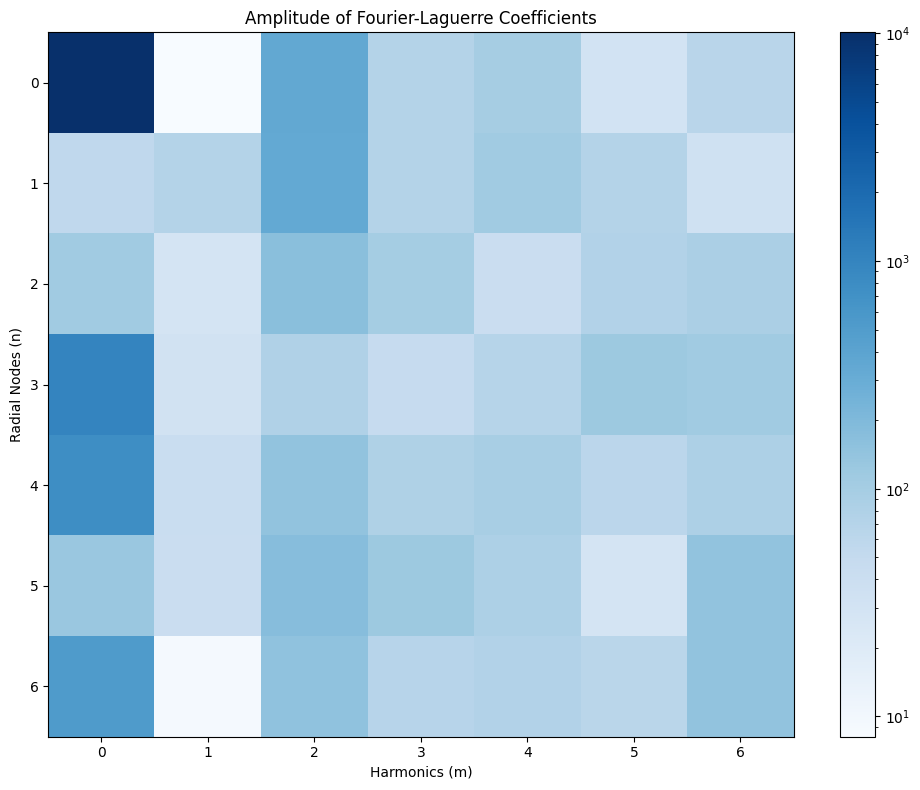

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


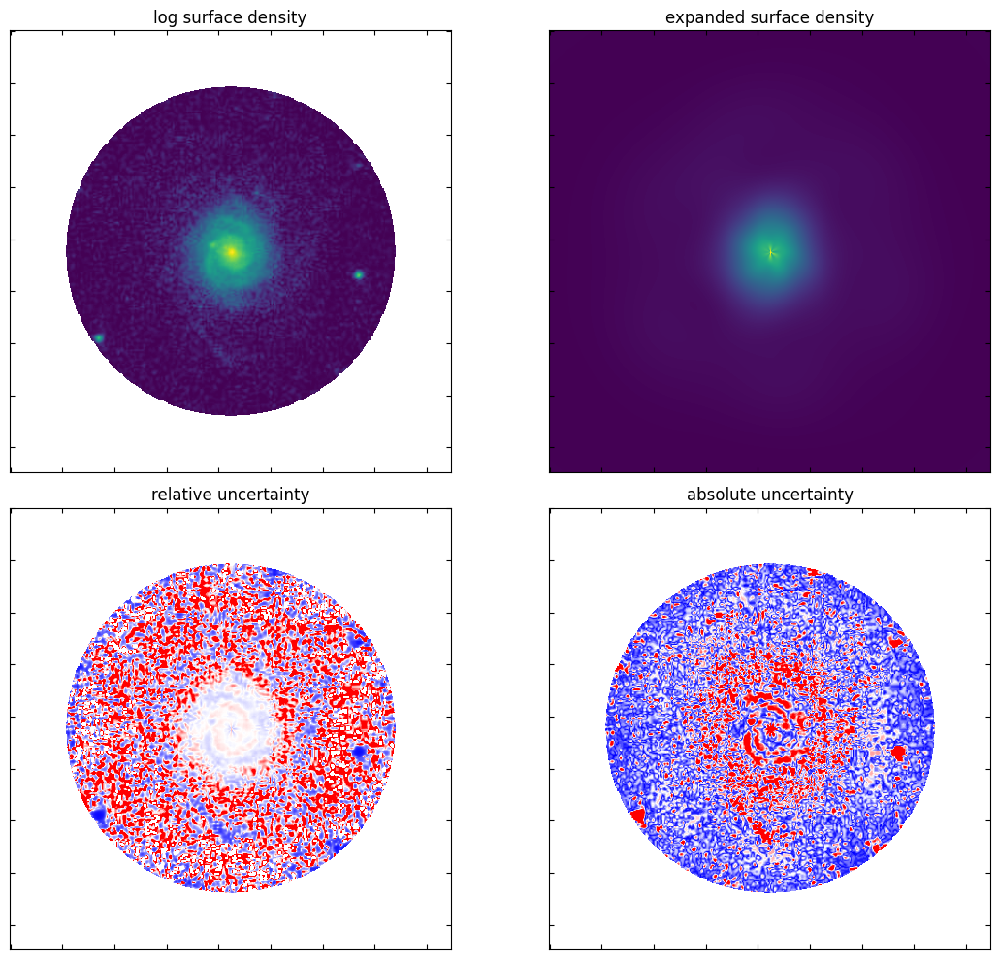

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 19/19 [00:00<00:00, 584.76it/s]

Saved 295140_spiral_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 295140_spiral_mapping2.wav to 295140_spiral_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   243.65x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   250.83x|    0:00 
---------------

Reff =  20.63817466480598  Galaxy Radius:  123.82904798883588
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 0.6732390159494356 -0.18083069509718638
center finding iteration 0
center finding iteration 50
Center of mass at x = 1.0898628823710808, y = 1.4791003176028275
finding best rscl
New rscl value: 29
updating to new_mmax, new_nmax


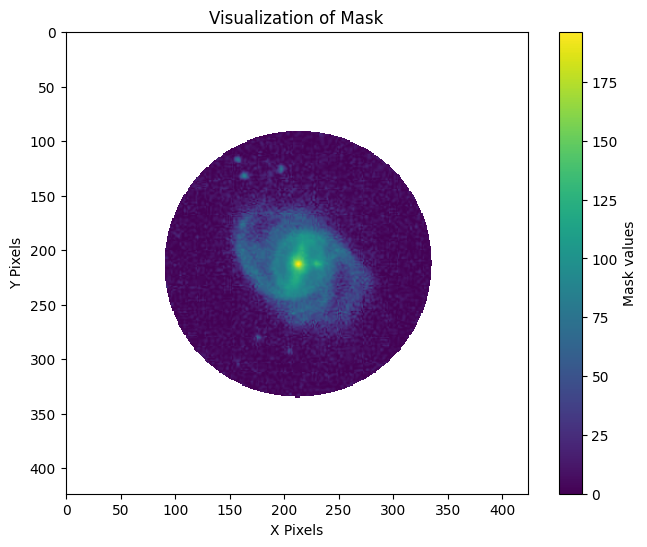

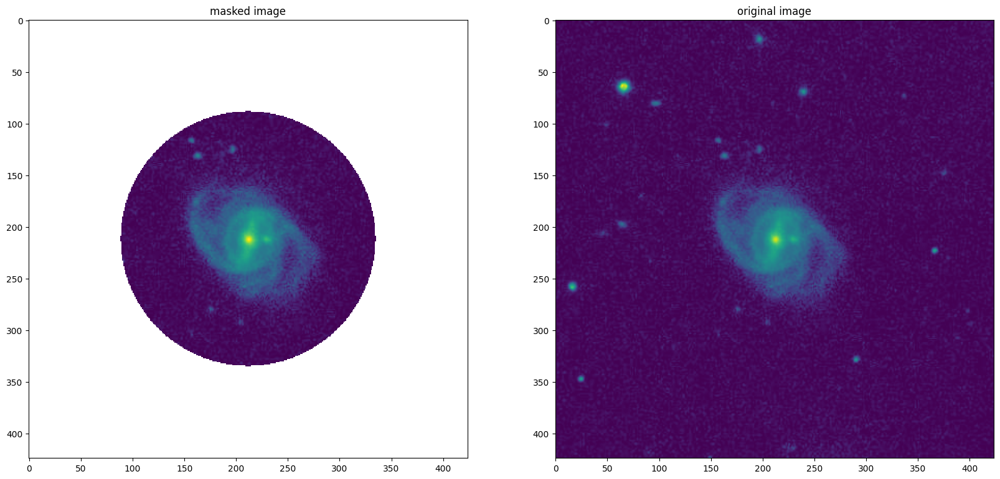

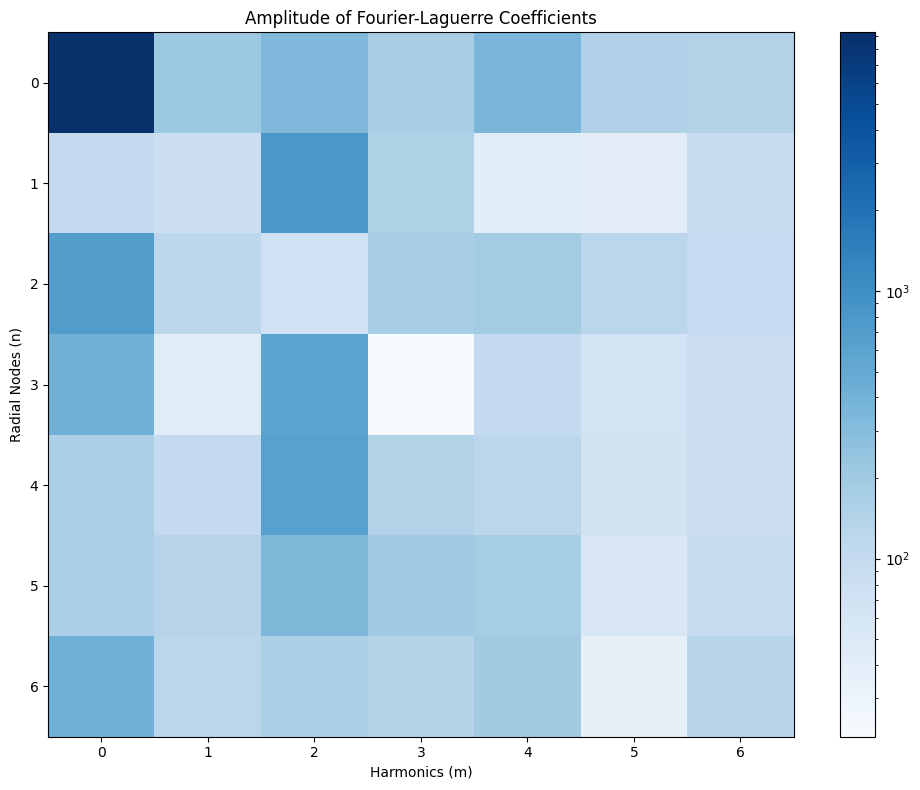

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


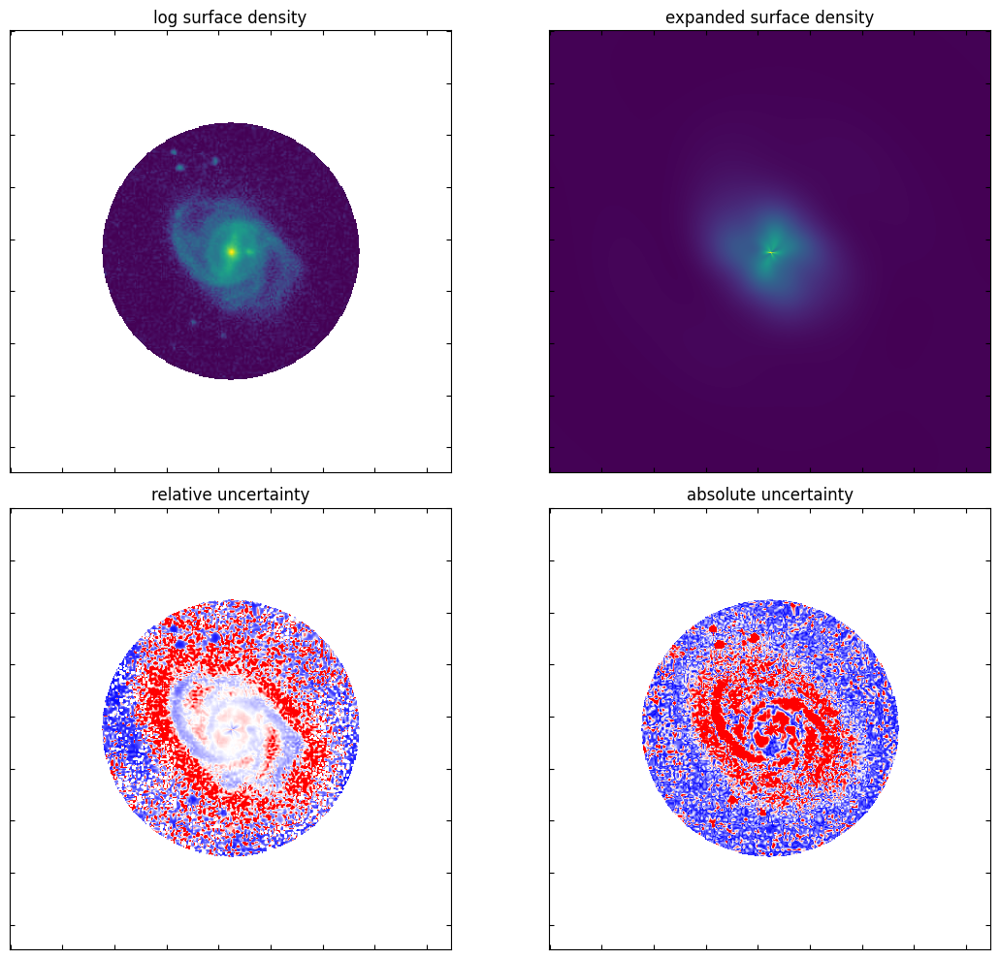

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 36/36 [00:00<00:00, 510.94it/s]

Saved 290722_barred_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 290722_barred_mapping2.wav to 290722_barred_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   249.43x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   257.10x|    0:00 
---------------

barred
opening image
Reff =  9.580536539818695  Galaxy Radius:  57.48321923891217
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 0.7546586623795515 1.2345481571633203
center finding iteration 0
Center of mass at x = 0.983049092355355, y = 1.4152826160789291
finding best rscl
New rscl value: 25
updating to new_mmax, new_nmax


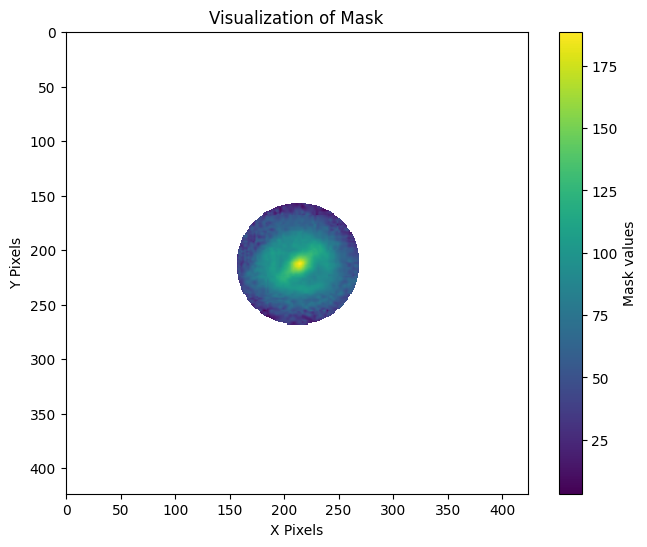

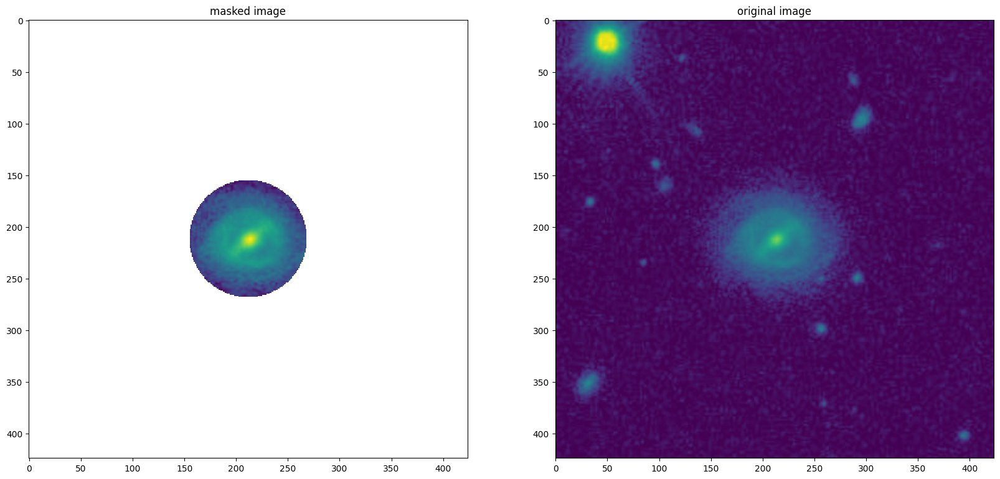

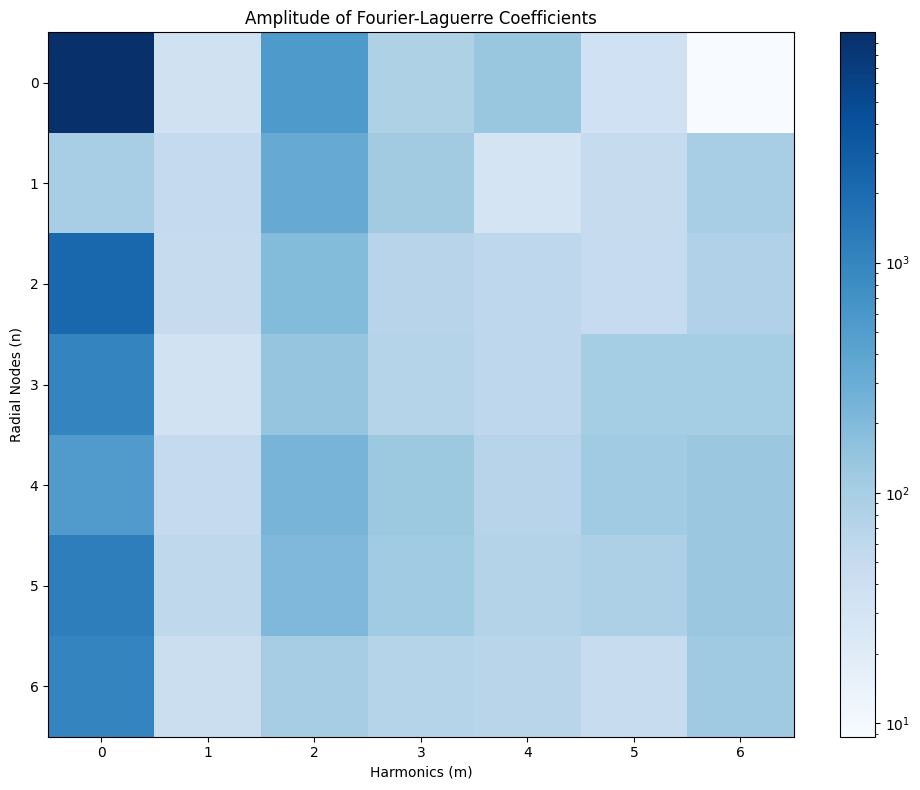

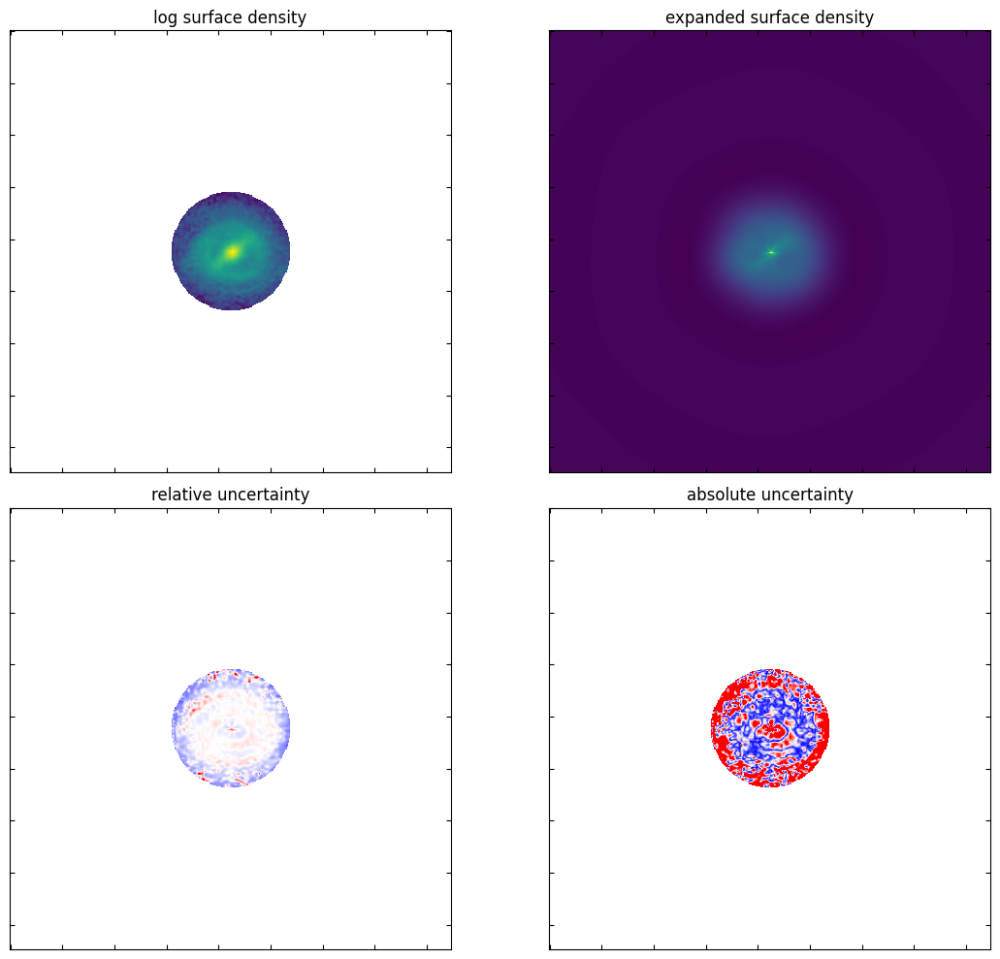

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 24/24 [00:00<00:00, 575.18it/s]

Saved 288813_barred_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 288813_barred_mapping2.wav to 288813_barred_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   245.32x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   254.29x|    0:00 
---------------

Reff =  45.15998636442438  Galaxy Radius:  270.95991818654625
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -3.153402810796072 0.3771012836070632
center finding iteration 0
Center of mass at x = 1.785110565648262, y = 1.913424946102412
finding best rscl
New rscl value: 29
updating to new_mmax, new_nmax


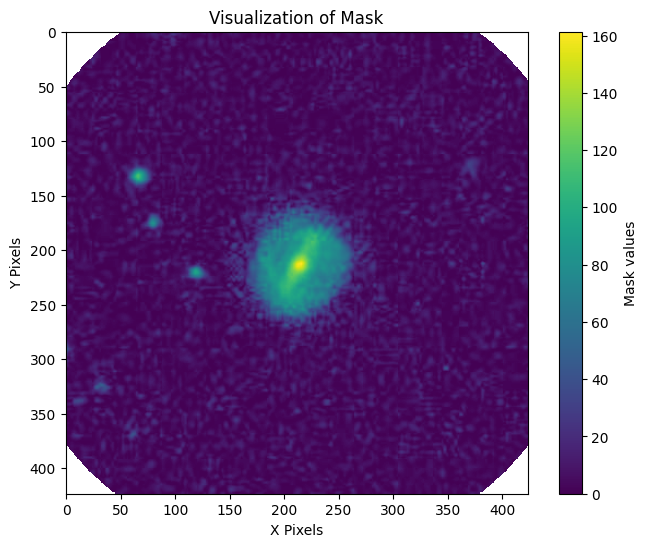

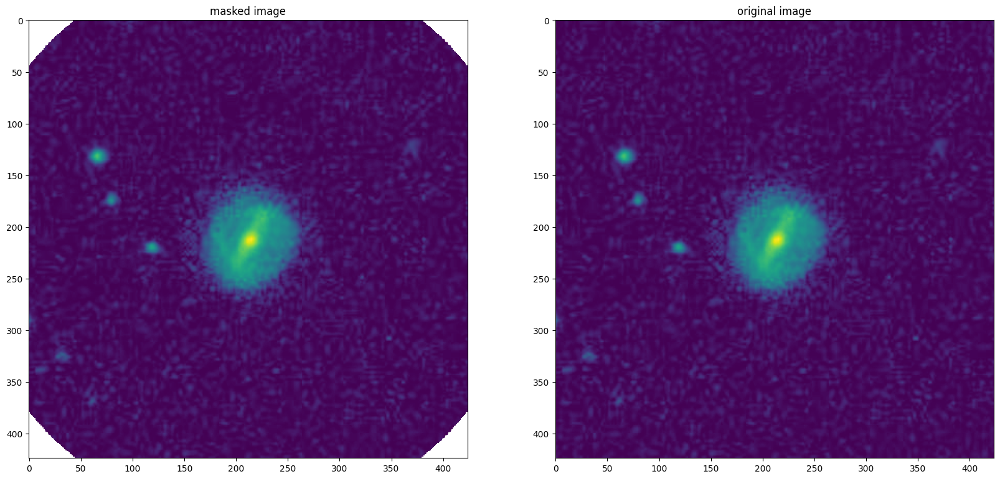

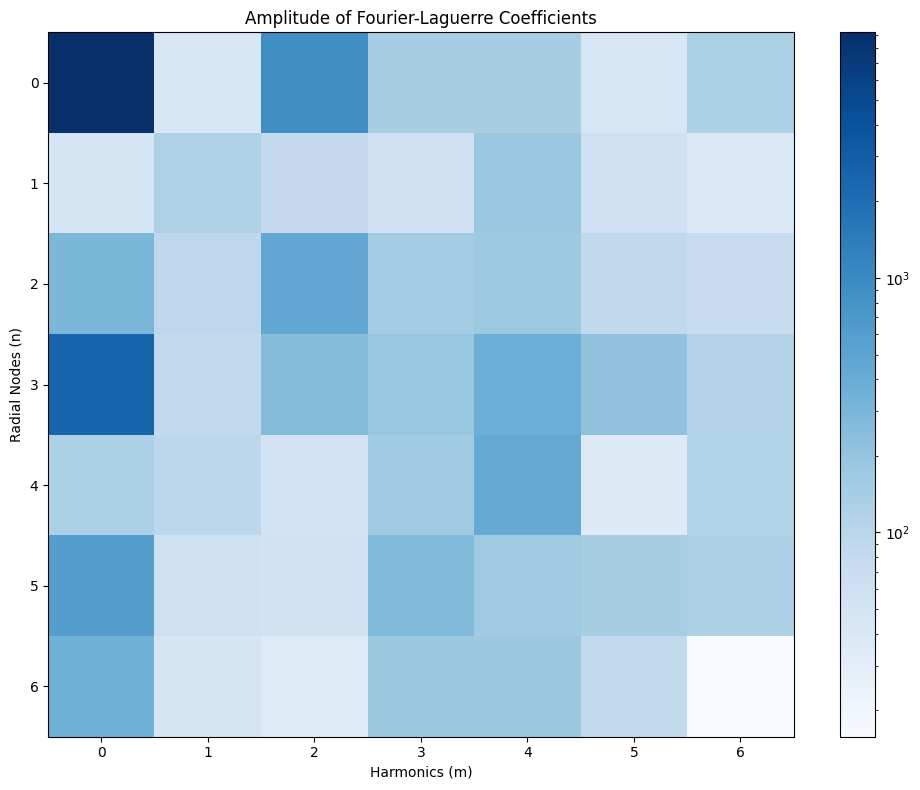

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


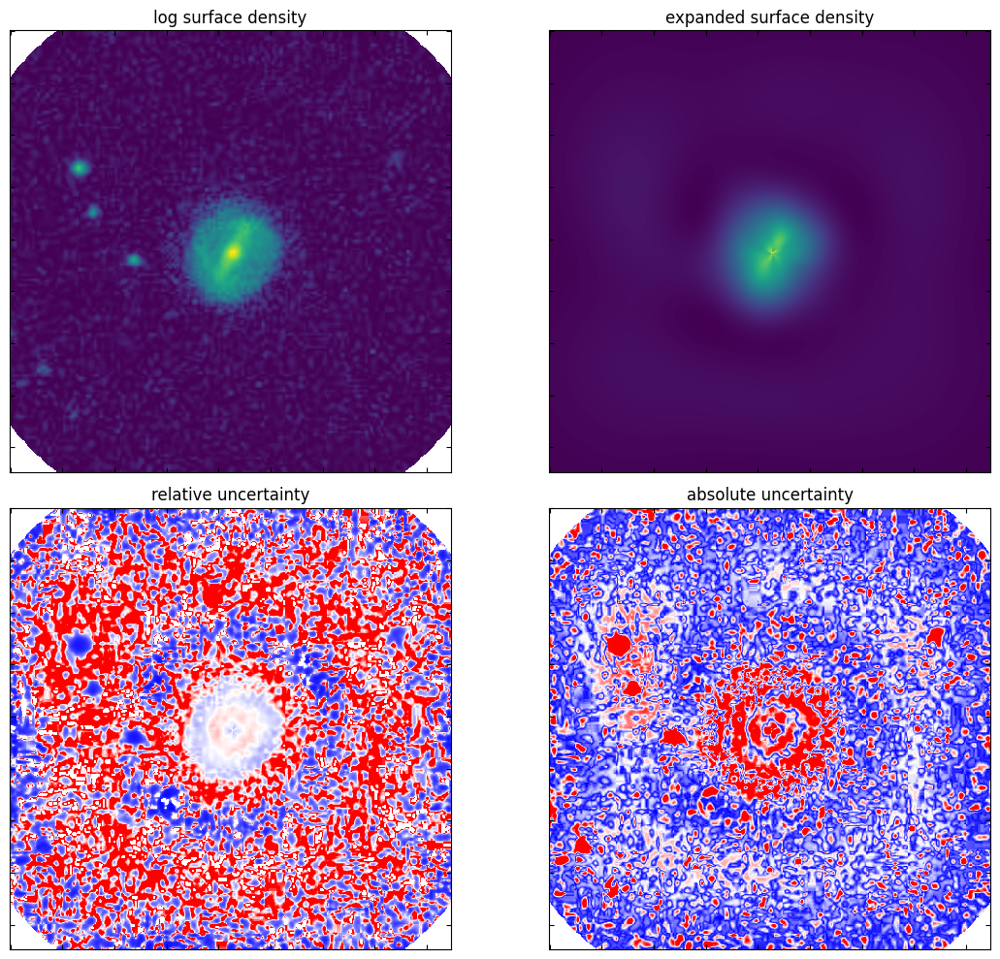

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 30/30 [00:00<00:00, 405.87it/s]

Saved 294348_barred_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 294348_barred_mapping2.wav to 294348_barred_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   241.94x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   250.70x|    0:00 
---------------

interacting
opening image
Reff =  30.853802565953632  Galaxy Radius:  185.1228153957218
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 25.940303051097867 -1.9765738479969805
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
center finding iteration 350
center finding iteration 400
center finding iteration 450
center finding iteration 500
center finding iteration 550
center finding iteration 600
center finding iteration 650
center finding iteration 700
Center of mass at x = 3.9540841332394443, y = 1.5060512652136078
finding best rscl
New rscl value: 48
updating to new_mmax, new_nmax


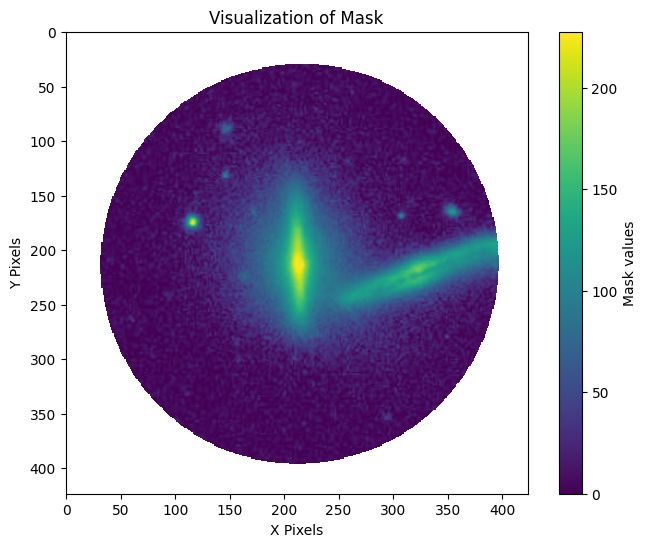

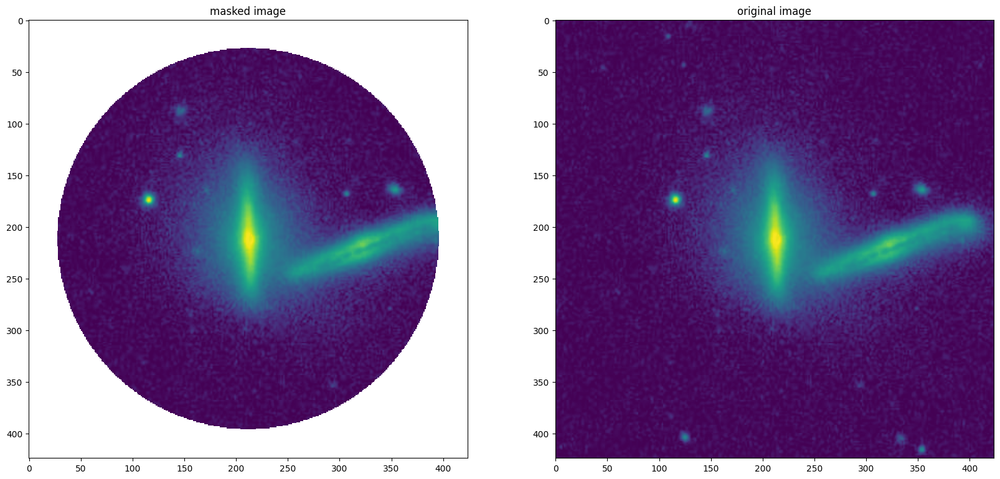

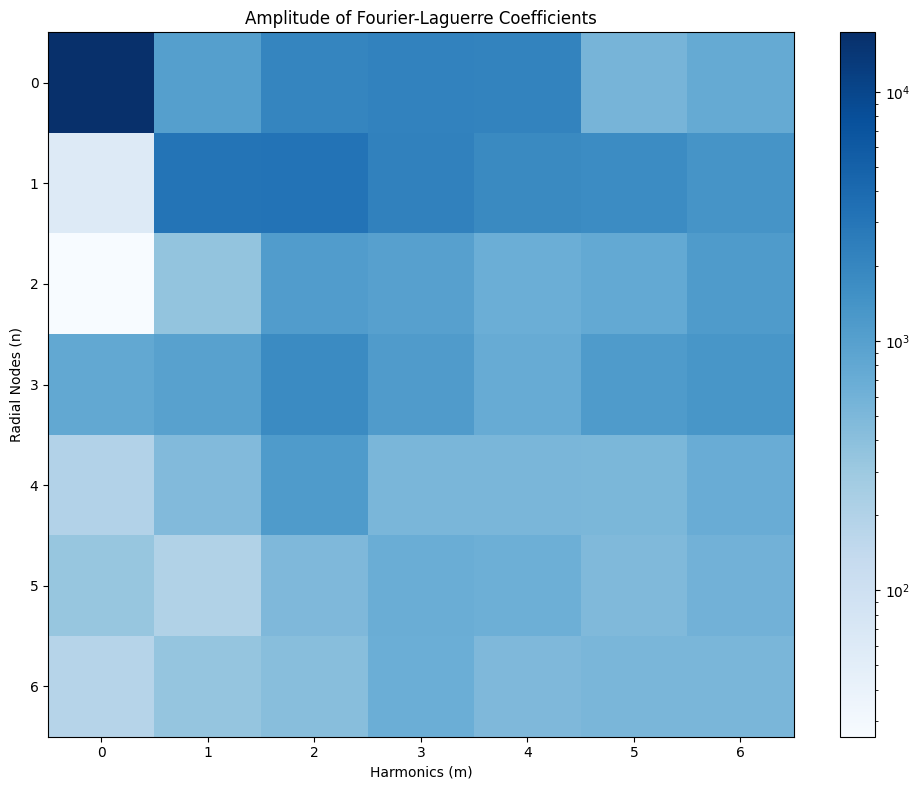

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


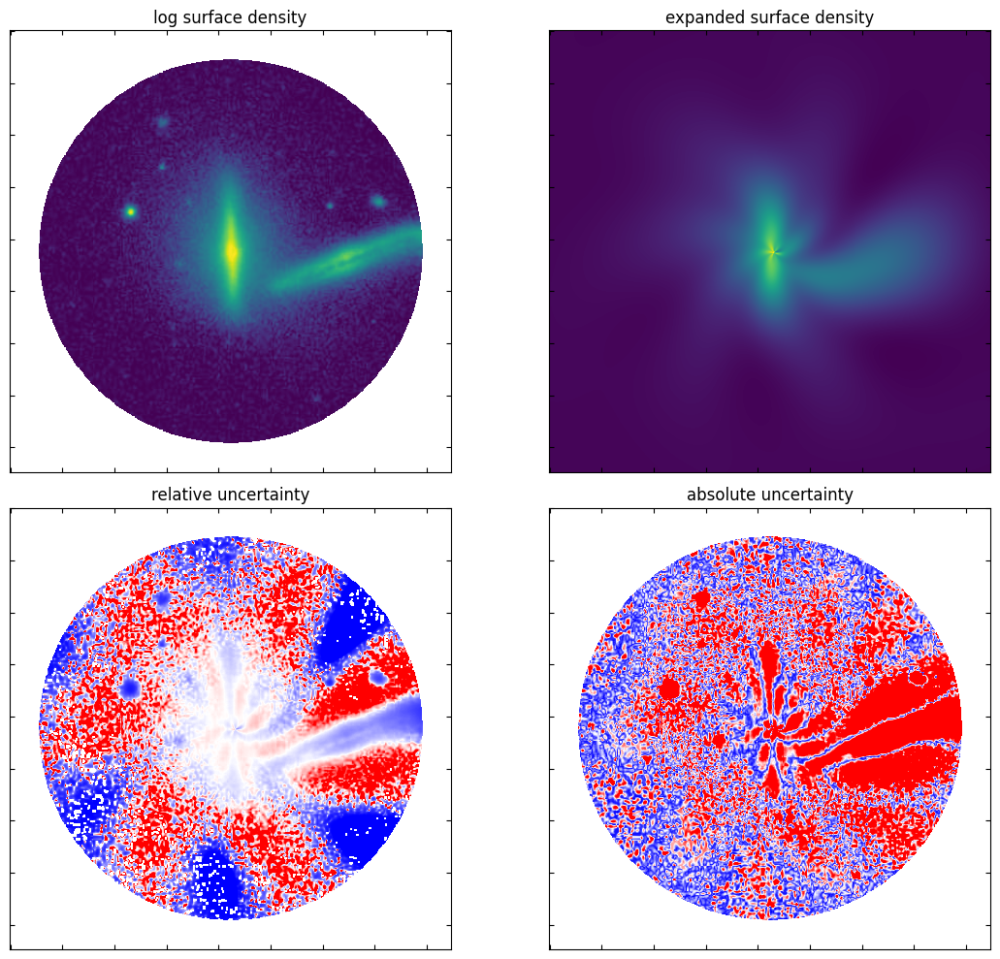

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 47/47 [00:00<00:00, 455.90it/s]

Saved 290026_interacting_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 290026_interacting_mapping2.wav to 290026_interacting_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:01/    0:01|   239.14x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:01/    0:01|   248.91x|    0:00 


interacting
opening image
Reff =  41.49194046975098  Galaxy Radius:  248.9516428185059
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 32.87486866720863 -34.95442051822159
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
center finding iteration 350
center finding iteration 400
center finding iteration 450
center finding iteration 500
center finding iteration 550
center finding iteration 600
center finding iteration 650
center finding iteration 700
center finding iteration 750
Center of mass at x = 38.901186972134184, y = -50.71807431798596
finding best rscl
New rscl value: 47
updating to new_mmax, new_nmax


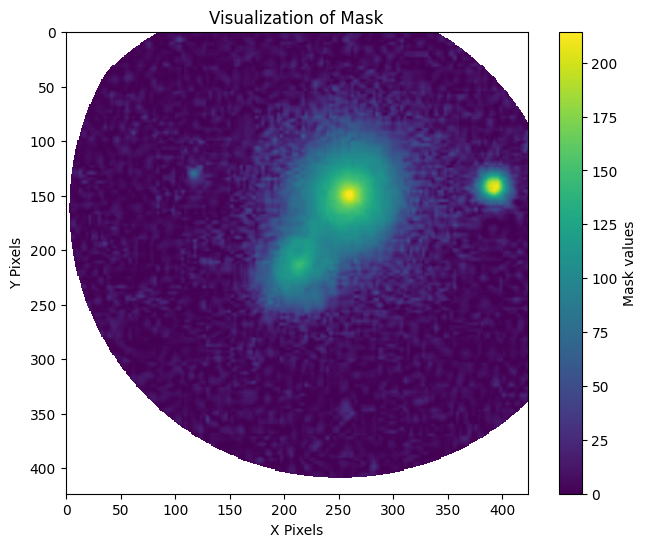

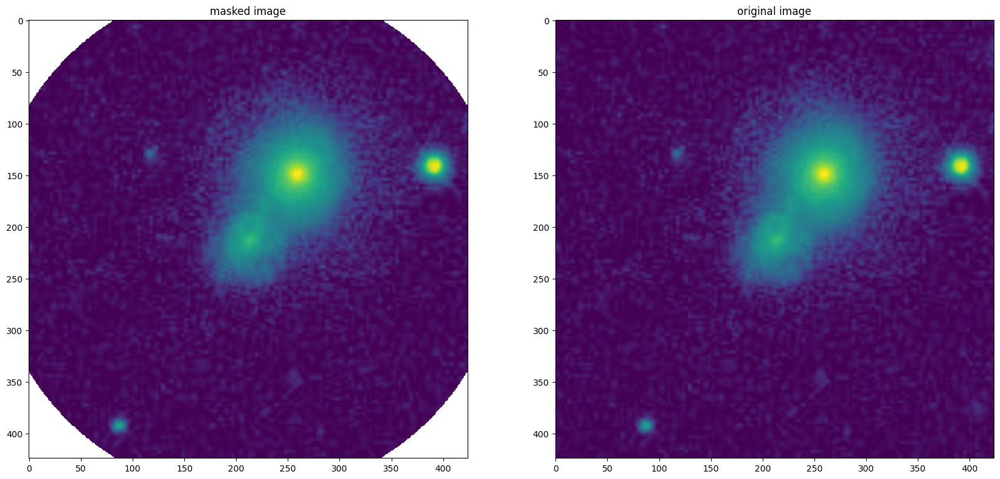

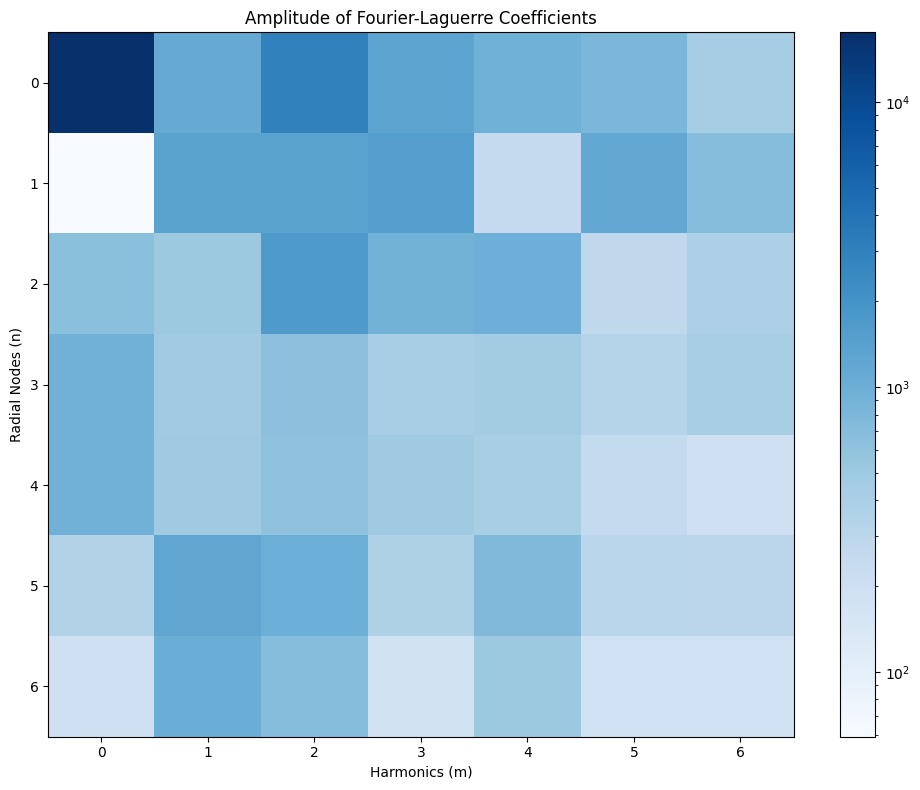

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


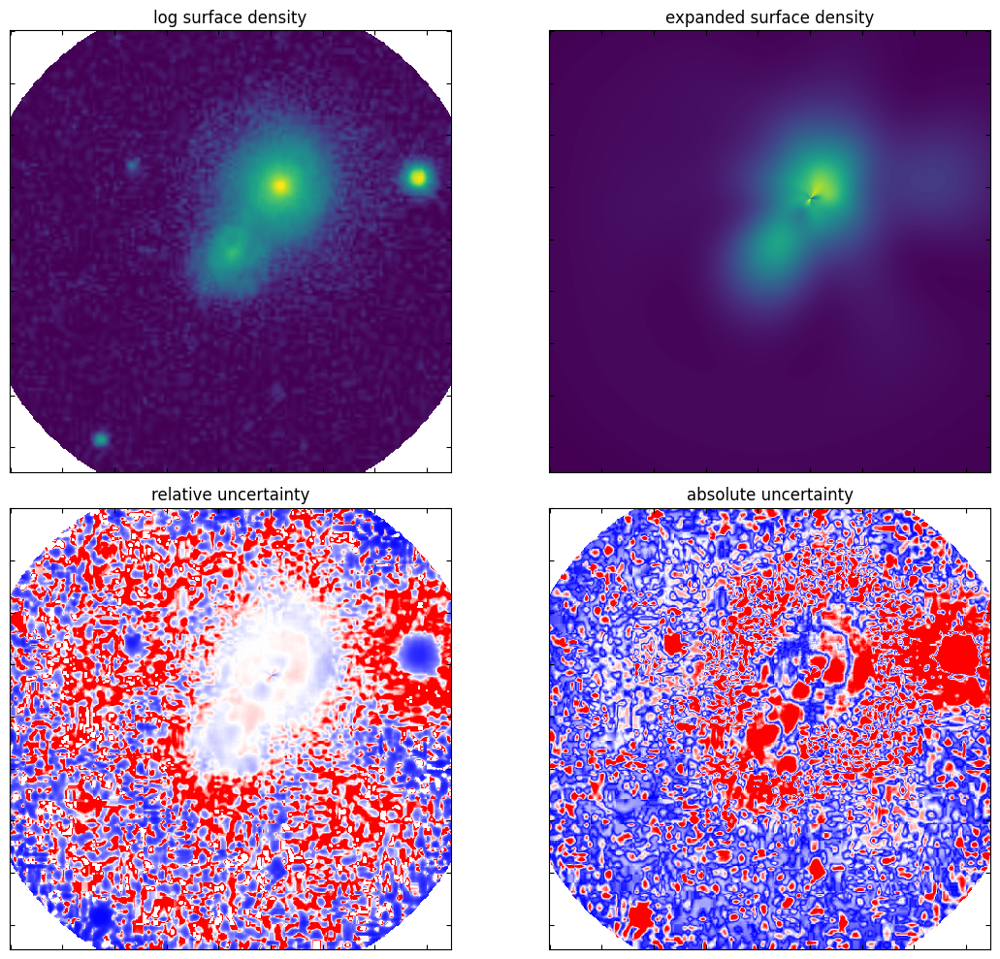

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 48/48 [00:00<00:00, 487.05it/s]

Saved 289500_interacting_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 289500_interacting_mapping2.wav to 289500_interacting_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   235.69x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   243.77x|    0:00 


interacting
opening image
Reff =  43.81981203511338  Galaxy Radius:  262.91887221068026
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 3.808607783256298 24.665881039354545
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
center finding iteration 350
center finding iteration 400
Center of mass at x = 3.4243401901225976, y = 41.07409740448874
finding best rscl
New rscl value: 55
updating to new_mmax, new_nmax


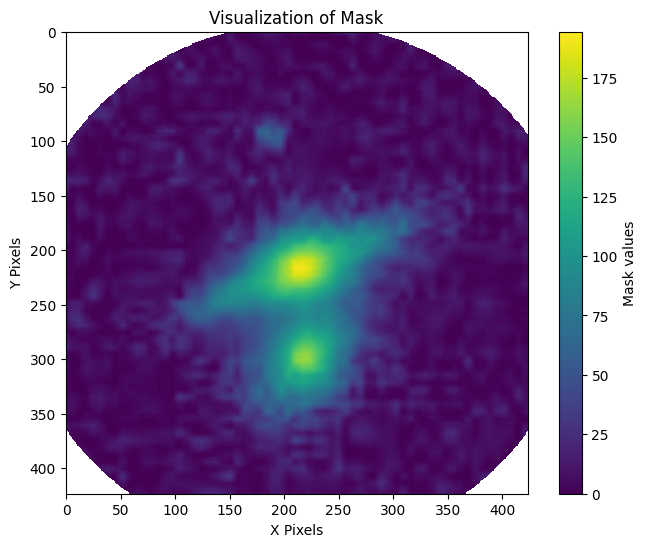

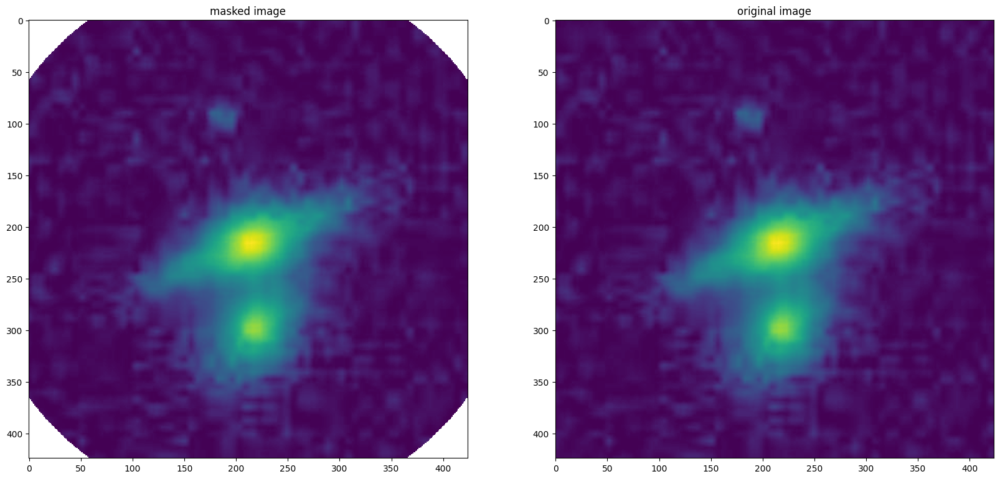

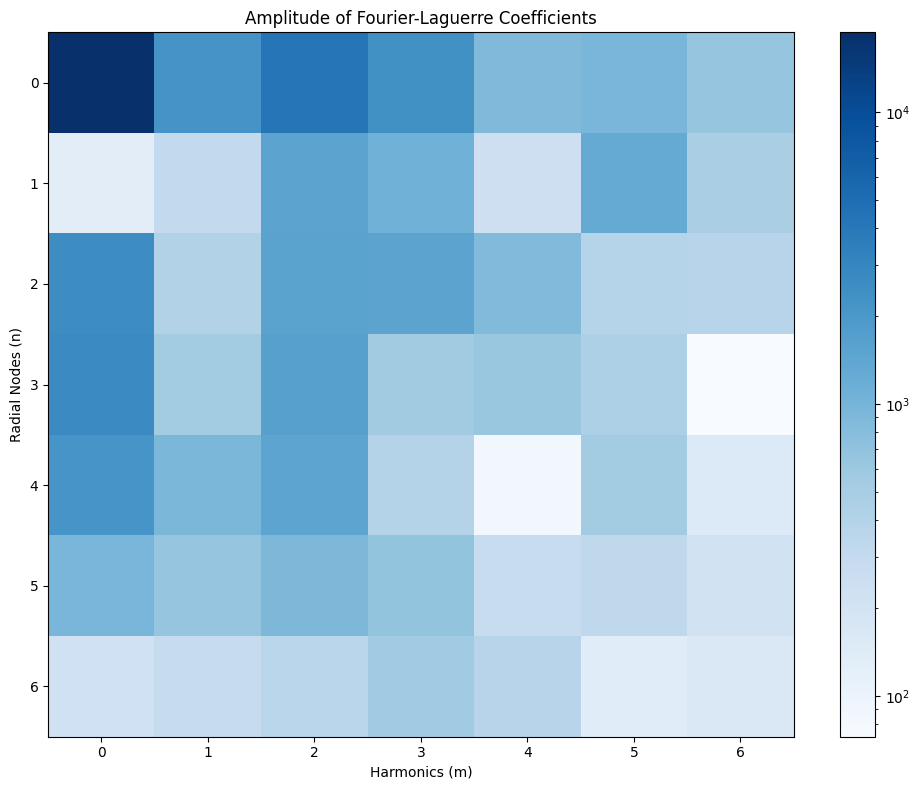

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


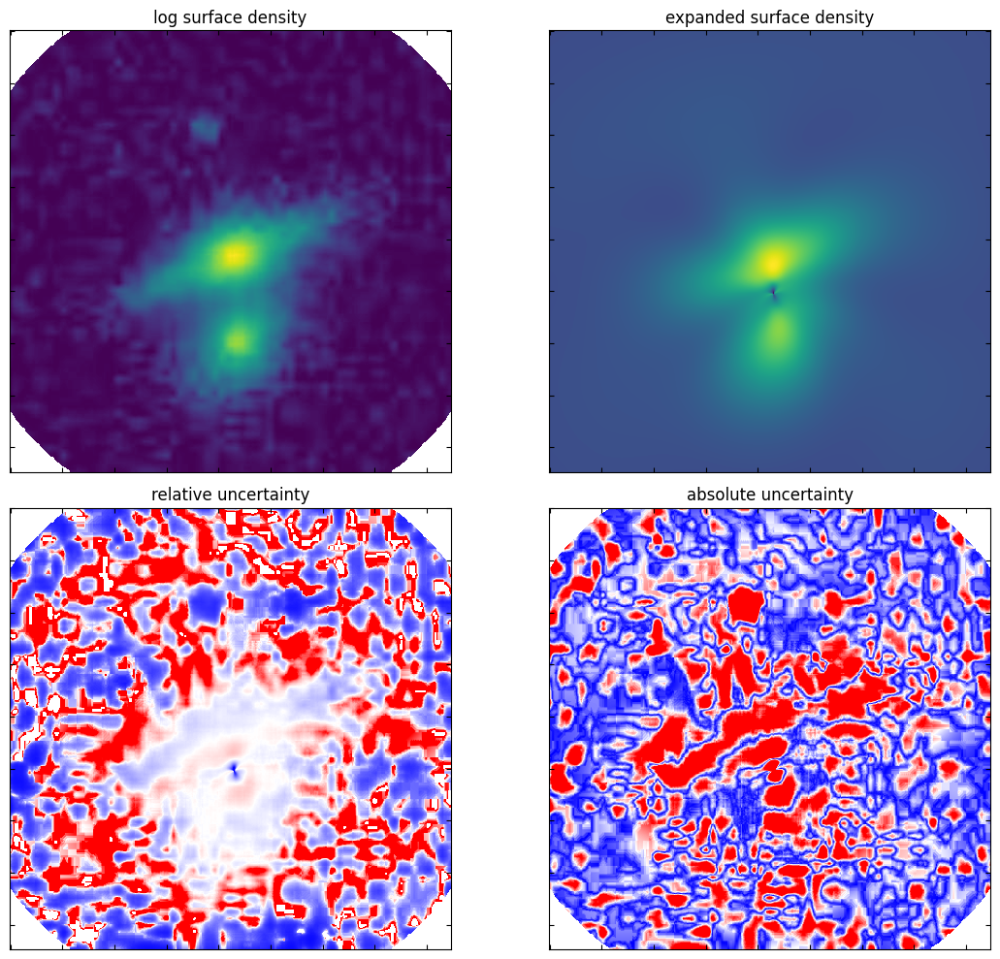

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 43/43 [00:00<00:00, 401.57it/s]

Saved 288109_interacting_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 288109_interacting_mapping2.wav to 288109_interacting_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   233.60x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   240.96x|    0:00 


artefact
opening image
Reff =  159.71728297165404  Galaxy Radius:  958.3036978299242
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate 20.33970119783361 65.65209802295692
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
center finding iteration 350
center finding iteration 400
center finding iteration 450
center finding iteration 500
center finding iteration 550
center finding iteration 600
center finding iteration 650
center finding iteration 700
Center of mass at x = 32.57633290125476, y = 103.2785329050588
finding best rscl
New rscl value: 46
updating to new_mmax, new_nmax


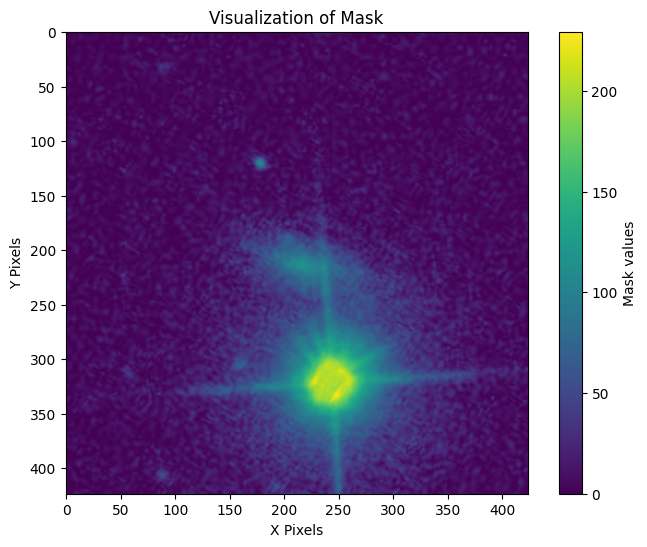

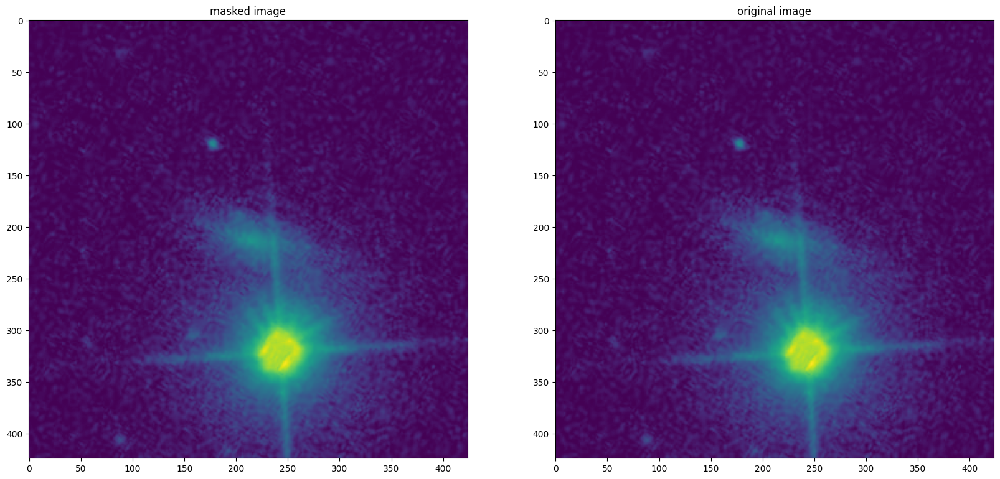

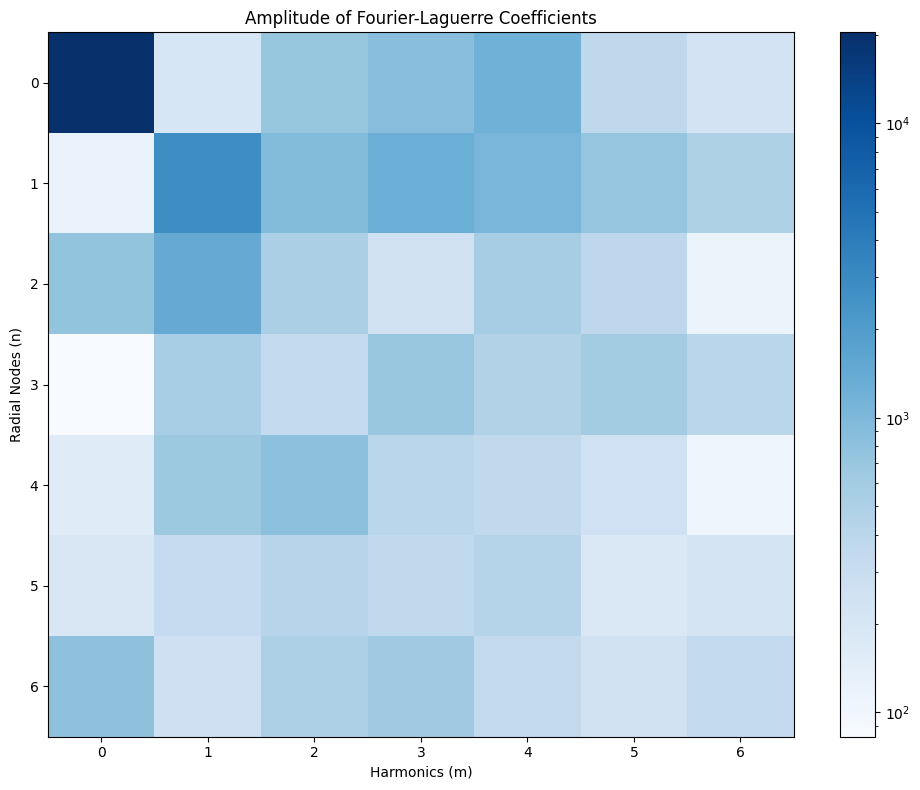

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


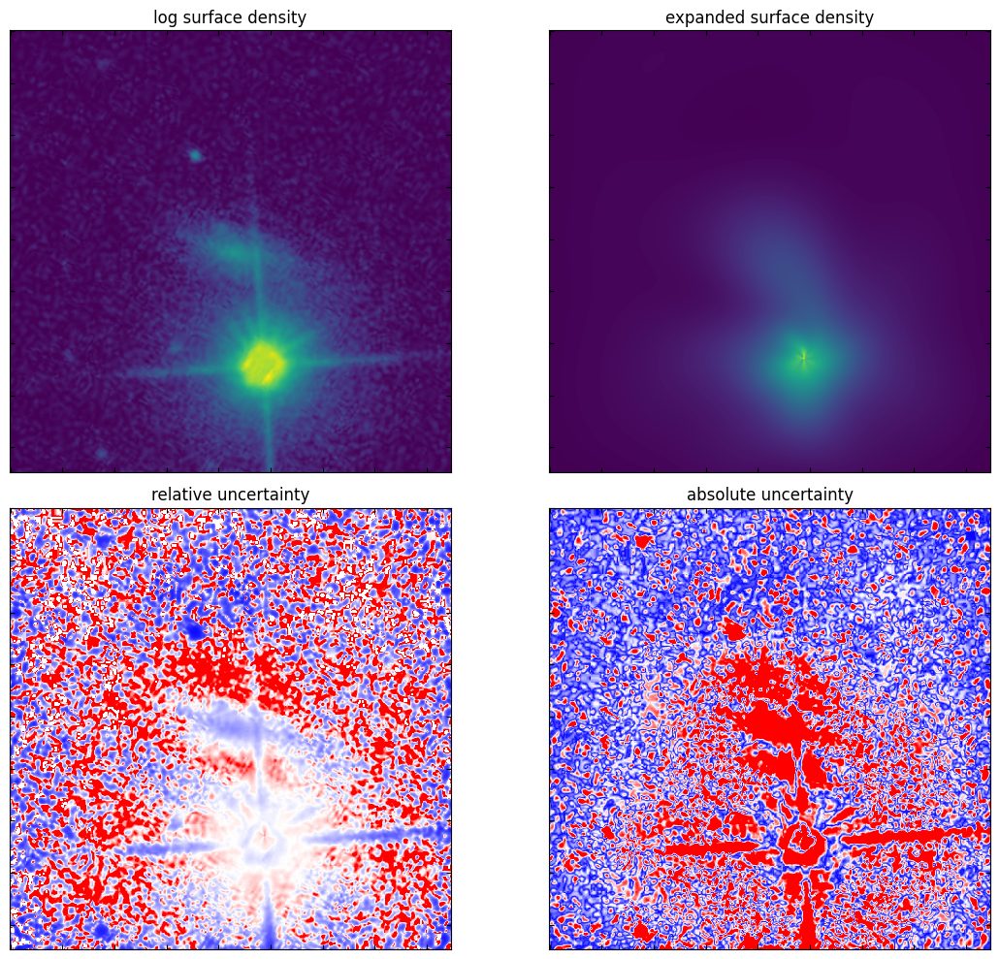

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 41/41 [00:00<00:00, 666.38it/s]

Saved 258142_artefact_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 258142_artefact_mapping2.wav to 258142_artefact_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   245.68x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   256.66x|    0:00 
---------

artefact
opening image
Reff =  81.62429328988861  Galaxy Radius:  489.7457597393317
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -29.525914007844502 33.44675939698196
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
center finding iteration 350
center finding iteration 400
center finding iteration 450
center finding iteration 500
center finding iteration 550
center finding iteration 600
center finding iteration 650
center finding iteration 700
center finding iteration 750
center finding iteration 800
center finding iteration 850
center finding iteration 900
center finding iteration 950
Center of mass at x = -37.45745314687093, y = 41.185868561279094
finding best rscl
New rscl value: 43
updating to new_mmax, new_nmax


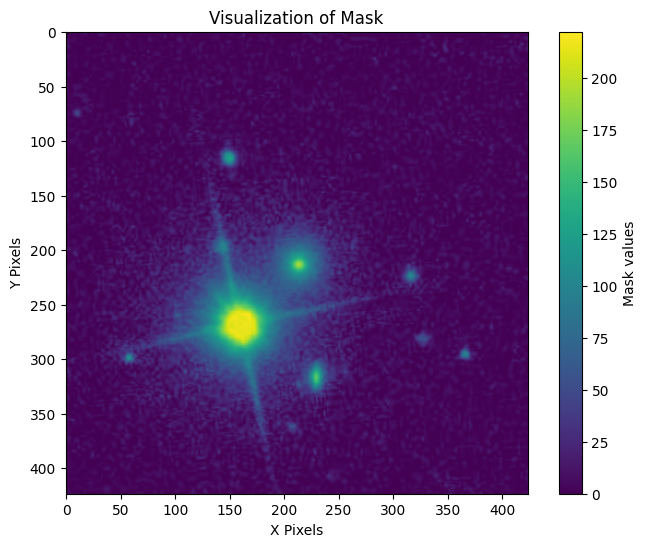

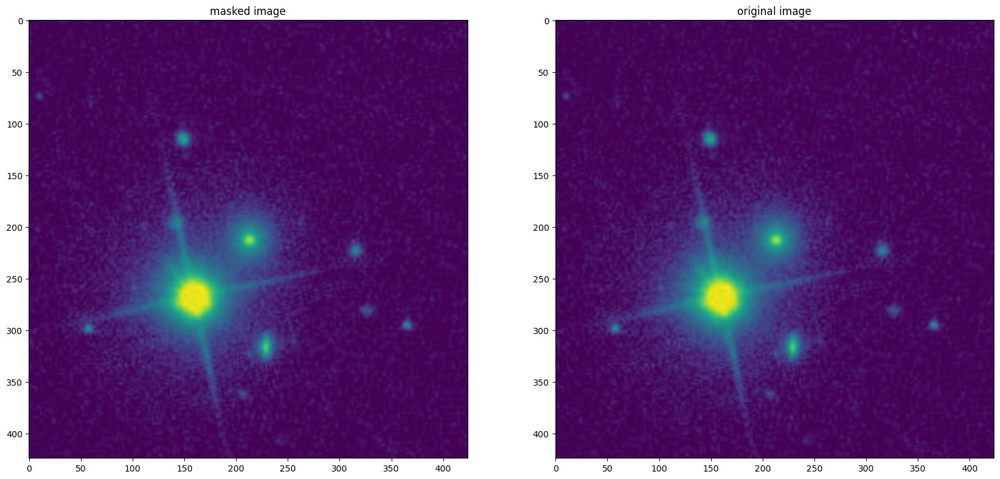

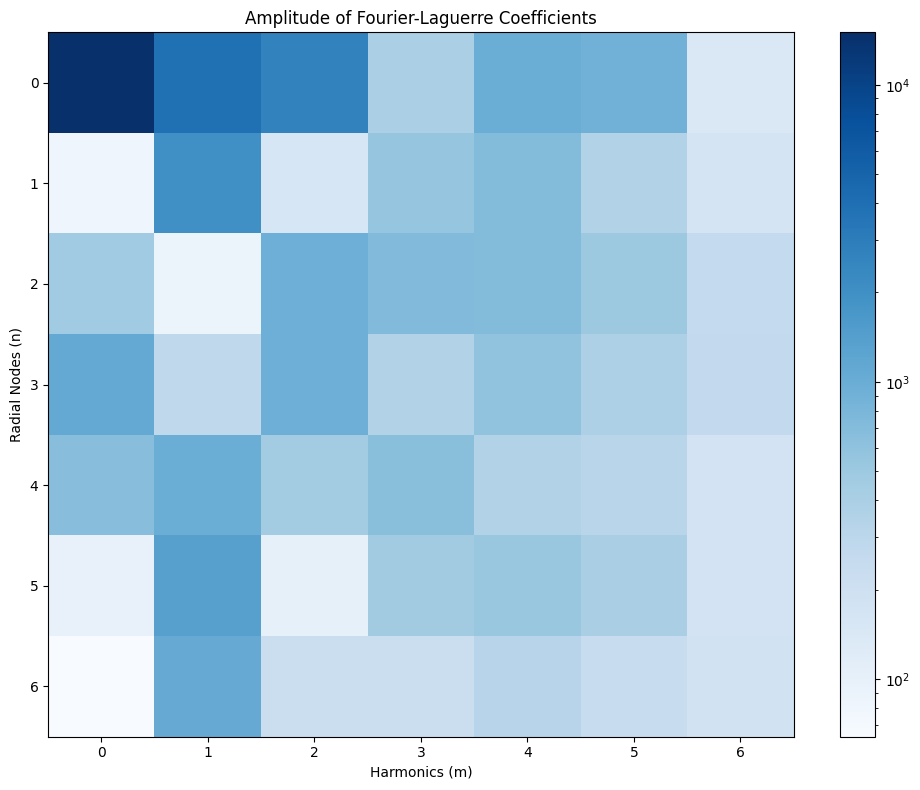

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


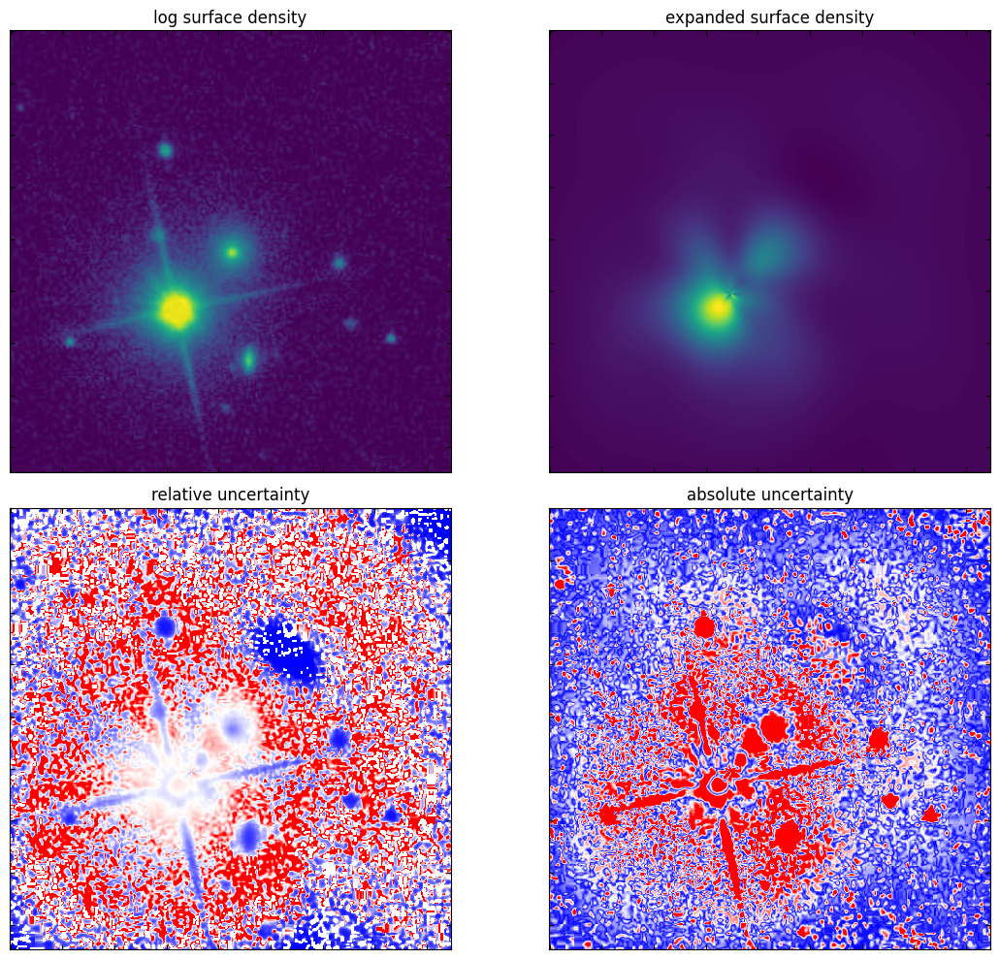

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 43/43 [00:00<00:00, 472.66it/s]

Saved 169394_artefact_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 169394_artefact_mapping2.wav to 169394_artefact_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   236.15x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   246.88x|    0:00 
---------

artefact
opening image
Reff =  161.28142891047307  Galaxy Radius:  967.6885734628383
getting pixel info, galaxy radius, mask, etc
finding center of image
center of mass estimate -55.60331792017055 -27.3942212065401
center finding iteration 0
center finding iteration 50
center finding iteration 100
center finding iteration 150
center finding iteration 200
center finding iteration 250
center finding iteration 300
Center of mass at x = -84.18037200868108, y = -40.60492751423814
finding best rscl
New rscl value: 53
updating to new_mmax, new_nmax


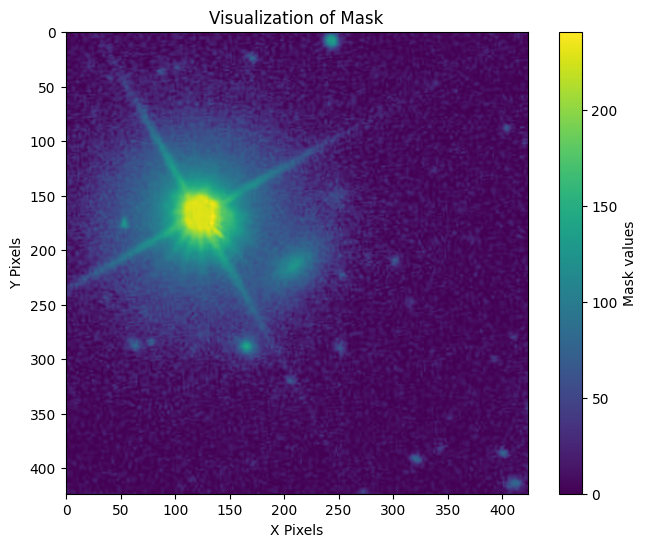

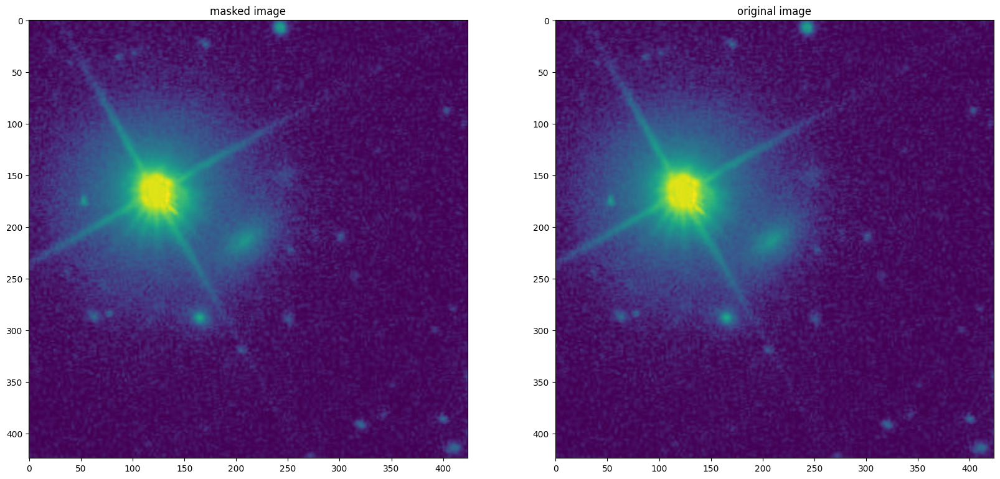

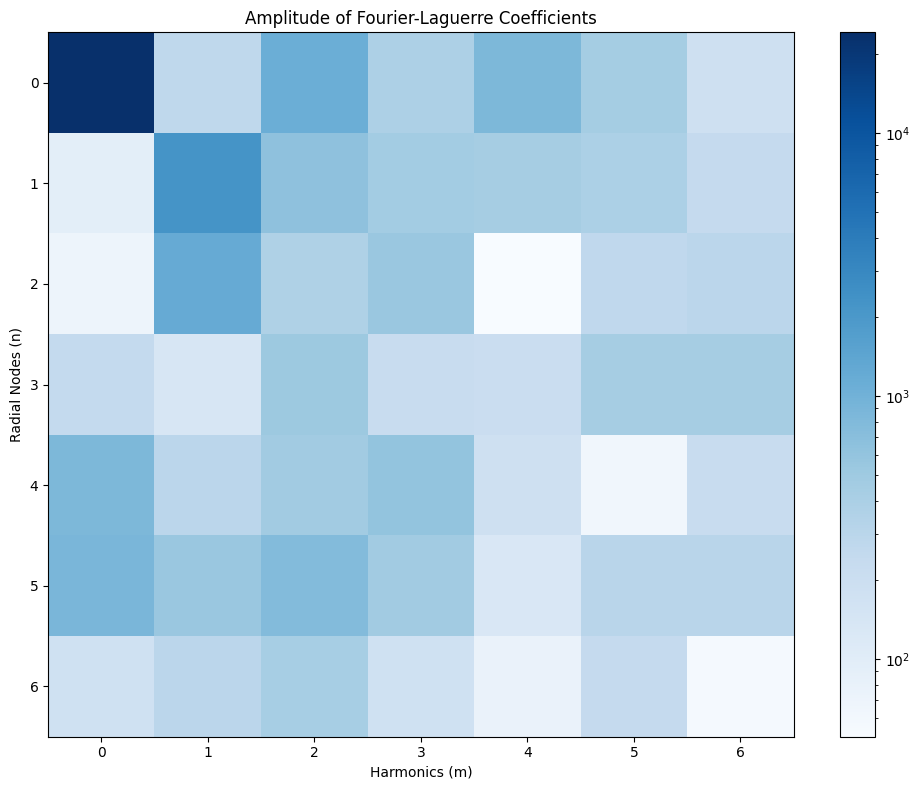

/Users/cfilion/Developer/sonification/survey_mappings/../FLEX_ed.py:721: RuntimeWarning: divide by zero encountered in divide
  ax3.imshow(((reconstruction - fixed_image) / fixed_image).T,cmap='bwr',vmin=-1,vmax=1)


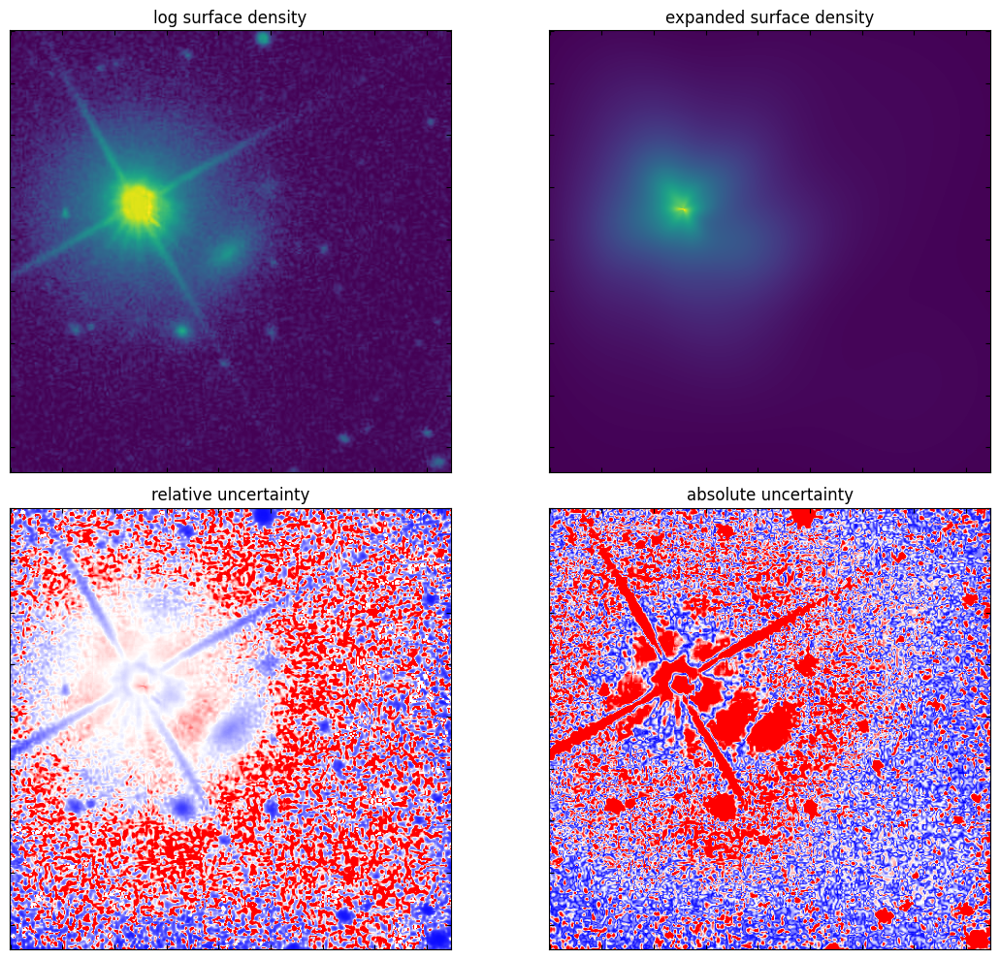

returning cosine coefficients, sine coefficients
returning full set of notes


100%|████████████████████████████████████████████| 32/32 [00:00<00:00, 572.00it/s]

Saved 261434_artefact_mapping2.wav
LAME 3.100 64bits (http://lame.sf.net)
Using polyphase lowpass filter, transition band: 16452 Hz - 17032 Hz
Encoding 261434_artefact_mapping2.wav to 261434_artefact_mapping2.mp3
Encoding as 48 kHz single-ch MPEG-1 Layer III (12x)  64 kbps qval=3
    Frame          |  CPU time/estim | REAL time/estim | play/CPU |    ETA 
     0/       ( 0%)|    0:00/     :  |    0:00/     :  |         x|     :  
00:03--------------------------------------------------------------------------
   kbps      %     %
     0/126    ( 0%)|    0:00/    0:00|    0:00/    0:00|   0.0000x|    0:00 
00:03--------------------------------------------------------------------------
   kbps      %     %
   100/126    (79%)|    0:00/    0:00|    0:00/    0:00|   243.83x|    0:00 
-----------------------------------------------------------00:00---------------
   kbps       mono %     long switch short %
   126/126   (100%)|    0:00/    0:00|    0:00/    0:00|   253.99x|    0:00 
---------

In [19]:
full_collection = [elliptical, edge_on, spiral, barred, interacting, artefact]
coefs = {}
name_list = []
length = 3
for galtype in full_collection:
    if 'GZ2_images/844.jpg' in galtype:
        gt = 'elliptical'
    elif 'GZ2_images/99129.jpg' in galtype:
        gt = 'edge_on'
    elif 'GZ2_images/290248.jpg' in galtype:
        gt = 'spiral'
    elif 'GZ2_images/290722.jpg' in galtype:
        gt = 'barred'
    elif 'GZ2_images/290026.jpg' in galtype:
        gt = 'interacting'
    elif 'GZ2_images/261434.jpg' in galtype:
        gt = 'artefact'

    for image in galtype:
        print(gt)
        cos_cos77, sin_cos77 = BeefIt('../'+str(image), rscl_initial = 10, 
                                            mmax_initial = 2, nmax_initial = 10,
                                           new_mmax = 7, new_nmax = 7)
        image_name = image.split('/')[1]
        image_name = image_name.split('.')[0]
        coefs[image_name+'_sine'] = sin_cos77
        coefs[image_name+'_cosine'] = cos_cos77

        note_dict = mod_map_to_sounds_octave_ampcutoff(cos_cos77, sin_cos77)
        score =  Score([list(note_dict.keys())], length)
        data = {'pitch': np.ones(len(note_dict.keys())),
               'volume': np.ones(len(note_dict.keys()))} #eventually want to make volume scale with importance somehow
        sources = Events(data.keys())
        sources.fromdict(data)
        lims = {'time': ('0','101')}
        sources.apply_mapping_functions(map_lims=lims)
        
        system = "mono"
        soni = Sonification(score, sources, test1_generator, system)
        soni.render()
        
        soni.save(str(image_name)+'_'+gt+'_mapping2.wav')
        #converting to MP3 - based on this: https://gist.github.com/kroger/6211862

        #! fluidsynth -F "{image_name}_{gt}_mapping2" "../GeneralUser-GS.sf2" "{image_name}_{gt}_mapping2.midi" && \
        #    lame "{image_name}_{gt}_mapping2"
        ! lame "{image_name}_{gt}_mapping2.wav" "{image_name}_{gt}_mapping2.mp3"
        os.remove(str(image_name)+'_'+str(gt)+'_mapping2.wav')